# Generating Embeddings

- In this Notebook, we'll generate Embeddings for Fashion Items that were scraped from the Myntra Website.
- We'll use the trained Embedding Models for different ategories like, Topwear, Bottomwear and Footwear for this purpose.

In [1]:
import os
import numpy as np
import random
import pandas as pd
from tqdm import tqdm
import tensorflow as tf
from tensorflow.keras.models import load_model
import matplotlib.pyplot as plt
from PIL import Image
from skimage import io

In [2]:
TARGET_SHAPE = (224,224,3)
def preprocess_image(filename: str):
    """
    Load the specified file as a JPEG image, preprocess it and
    resize it to the target shape.
    
    Args:
        filename: Absolute / Relative file path for the image
    
    Returns:
        Preprocessed inputs of type tensorflow.Tensor for Embedding Generation 
    """
    image_string = tf.io.read_file(filename)
    image = tf.image.decode_jpeg(image_string, channels=3)
    image = tf.image.convert_image_dtype(image, tf.float32)
    image = tf.image.resize(image, TARGET_SHAPE[:2])
    return tf.expand_dims(image, axis=0)


def generate_embedding(dataframe, embedding_generator):
    """
    Use the specified dataframe and Embeddings model to 
    calculate embeddings for all records in the dataframe
    
    Args:
        dataframe: Dataframe to get records for Embedding Generation
        embedding_genrator: Tensorflow Model to generate embeddings
    
    Returns:
        Dataframe with embeddings for each record.
    """
    embeddings = list()
    for i, row in tqdm(dataframe.iterrows(), total=dataframe.shape[0]):
        filename = row["local_path"]
        image = preprocess_image(filename)
        embedding = embedding_generator(image)
        embeddings.append(embedding[0].numpy().astype(np.float32).tolist())
    dataframe["embedding"] = embeddings
    return dataframe

In [3]:
df = pd.read_csv("./Scrapped_dataframe/final-scraped-myntra-fashion-products.csv")
print(df.shape)
df.head()

(16787, 8)


,product_id,product_url,image_url,description,brand,gender,category,type
0,mtf_0000000001,https://www.myntra.com/blazers/manq/manq-men-b...,"https://assets.myntassets.com/dpr_2,q_60,w_210...",MANQ Men Black Slim Fit Solid Single Breasted ...,MANQ,men,topwear,formal
1,mtf_0000000002,https://www.myntra.com/blazers/peter+england+e...,"https://assets.myntassets.com/dpr_2,q_60,w_210...",Peter England Elite Self-Design Single-Breaste...,Peter,men,topwear,formal
2,mtf_0000000003,https://www.myntra.com/blazers/louis+philippe/...,"https://assets.myntassets.com/dpr_2,q_60,w_210...",Louis Philippe Textured Self Design Slim Fit S...,Louis,men,topwear,formal
3,mtf_0000000004,https://www.myntra.com/blazers/the+indian+gara...,"https://assets.myntassets.com/dpr_2,q_60,w_210...",The Indian Garage Co Men Grey Solid Single-Bre...,The,men,topwear,formal
4,mtf_0000000005,https://www.myntra.com/blazers/peter+england+e...,"https://assets.myntassets.com/dpr_2,q_60,w_210...",Peter England Elite Men Navy Blue Solid Slim-F...,Peter,men,topwear,formal


In [4]:
df.isna().sum()

product_id     0
product_url    0
image_url      0
description    0
brand          0
gender         0
category       0
type           0
dtype: int64

In [5]:
import os
import requests


def download_images_and_add_local_path(df, image_url_column='image_url', download_dir='downloaded_images'):
    """
    Downloads images from the URLs specified in the image_url column of the DataFrame
    and stores them in the local path. A new column 'local_path' is created to store
    the path of the downloaded images.

    Args:
    df (pd.DataFrame): The input DataFrame that contains the image URLs.
    image_url_column (str): The column name in the DataFrame that contains the image URLs.
    download_dir (str): The directory where the images will be downloaded.

    Returns:
    pd.DataFrame: The updated DataFrame with a new column 'local_path'.
    """
    # Ensure the download directory exists
    if not os.path.exists(download_dir):
        os.makedirs(download_dir)
    
    # Function to download a single image
    def download_image(url, download_dir):
        try:
            response = requests.get(url)
            response.raise_for_status()  # Ensure the request was successful
            image_name = os.path.basename(url)
            local_path = os.path.join(download_dir, image_name)
            with open(local_path, 'wb') as f:
                f.write(response.content)
            return local_path
        except requests.exceptions.RequestException as e:
            print(f"Error downloading {url}: {e}")
            return None
    
    # Apply the download function to each row
    tqdm.pandas()  # Progress bar for pandas
    df['local_path'] = df[image_url_column].progress_apply(lambda url: download_image(url, download_dir))
    
    return df


In [10]:
df = download_images_and_add_local_path(df)

100%|██████████| 16787/16787 [43:36<00:00,  6.42it/s] 


In [11]:
df

,product_id,product_url,image_url,description,brand,gender,category,type,local_path
0,mtf_0000000001,https://www.myntra.com/blazers/manq/manq-men-b...,"https://assets.myntassets.com/dpr_2,q_60,w_210...",MANQ Men Black Slim Fit Solid Single Breasted ...,MANQ,men,topwear,formal,downloaded_images\e2f9aa24-7e6e-49ef-b42c-318f...
1,mtf_0000000002,https://www.myntra.com/blazers/peter+england+e...,"https://assets.myntassets.com/dpr_2,q_60,w_210...",Peter England Elite Self-Design Single-Breaste...,Peter,men,topwear,formal,downloaded_images\0d06698f-bc34-43a3-adbf-48ed...
2,mtf_0000000003,https://www.myntra.com/blazers/louis+philippe/...,"https://assets.myntassets.com/dpr_2,q_60,w_210...",Louis Philippe Textured Self Design Slim Fit S...,Louis,men,topwear,formal,downloaded_images\00b445a5-7094-4d05-9ea4-7e9c...
3,mtf_0000000004,https://www.myntra.com/blazers/the+indian+gara...,"https://assets.myntassets.com/dpr_2,q_60,w_210...",The Indian Garage Co Men Grey Solid Single-Bre...,The,men,topwear,formal,downloaded_images\5ca9094c-b9d6-449f-b5ad-d081...
4,mtf_0000000005,https://www.myntra.com/blazers/peter+england+e...,"https://assets.myntassets.com/dpr_2,q_60,w_210...",Peter England Elite Men Navy Blue Solid Slim-F...,Peter,men,topwear,formal,downloaded_images\8216732d-470f-410d-8717-3a4e...
...,...,...,...,...,...,...,...,...,...
16782,hhh_0000000702,https://www.myntra.com/handbags/anouk/anouk-bl...,"https://assets.myntassets.com/dpr_2,q_60,w_210...",Anouk Blue Printed Structured Tote Bag with Cu...,Anouk,Both,handbags,handbags,downloaded_images\b3bb8587-dfe7-4a86-bba2-c5a0...
16783,hhh_0000000703,https://www.myntra.com/handbags/eske/eske-embe...,"https://assets.myntassets.com/dpr_2,q_60,w_210...",Eske Embellished Bowling Handheld Bag with Tas...,Eske,Both,handbags,handbags,downloaded_images\e637452c-8c67-4b9e-b25f-391e...
16784,hhh_0000000704,https://www.myntra.com/handbags/baggit/baggit-...,"https://assets.myntassets.com/dpr_2,q_60,w_210...",Baggit Women Printed Sling Bag,Baggit,Both,handbags,handbags,downloaded_images\41213ceb-adb2-4d12-9772-aa53...
16785,hhh_0000000705,https://www.myntra.com/handbags/forever+21/for...,"https://assets.myntassets.com/dpr_2,q_60,w_210...",FOREVER 21 Textured Structured Shoulder Bag,FOREVER,Both,handbags,handbags,downloaded_images\7b5e5966-5041-4e88-96c3-efe1...


In [ ]:
#Now because our STL triplet dataset we have used to train the siamese network does not have ethnic wear for men and women in it. So we have to remove those from our scrapped data as well.


In [15]:
unique_urls = df['image_url'].nunique()
total_rows = len(df)
print(f"Unique URLs: {unique_urls}, Total Rows: {total_rows}")


Unique URLs: 16280, Total Rows: 16787


In [6]:
df["gender"].value_counts()

gender
women    8487
men      7594
Both      706
Name: count, dtype: int64

In [7]:
df["category"].value_counts()

category
topwear         4761
bottomwear      4736
footwear        4562
eyewear         1417
handbags         706
full_topwear     605
Name: count, dtype: int64

In [8]:
df["type"].value_counts()

type
casual        3627
party         2970
formal        2940
ethnic        2707
sunglasses    1417
sports        1210
handbags       706
pyjama         605
onepiece       605
Name: count, dtype: int64

In [9]:
df_both = df[df["gender"]=='Both']
df_both["category"].value_counts()

category
handbags    706
Name: count, dtype: int64

In [14]:
df.isna().sum()

product_id     0
product_url    0
image_url      0
description    0
brand          0
gender         0
category       0
type           0
local_path     0
dtype: int64

In [52]:
#Now because our STL triplet dataset we have used to train the siamese network does not have ethnic wear for men and women in it. So we have to remove those from our scrapped data as well.
# Drop rows where the "type" column is equal to "ethnic" or "pyjama"
df = df[~df['type'].isin(['ethnic', 'pyjama'])]
df

,product_id,product_url,image_url,description,brand,gender,category,type,local_path
0,mtf_0000000001,https://www.myntra.com/blazers/manq/manq-men-b...,"https://assets.myntassets.com/dpr_2,q_60,w_210...",MANQ Men Black Slim Fit Solid Single Breasted ...,MANQ,men,topwear,formal,downloaded_images\e2f9aa24-7e6e-49ef-b42c-318f...
1,mtf_0000000002,https://www.myntra.com/blazers/peter+england+e...,"https://assets.myntassets.com/dpr_2,q_60,w_210...",Peter England Elite Self-Design Single-Breaste...,Peter,men,topwear,formal,downloaded_images\0d06698f-bc34-43a3-adbf-48ed...
2,mtf_0000000003,https://www.myntra.com/blazers/louis+philippe/...,"https://assets.myntassets.com/dpr_2,q_60,w_210...",Louis Philippe Textured Self Design Slim Fit S...,Louis,men,topwear,formal,downloaded_images\00b445a5-7094-4d05-9ea4-7e9c...
3,mtf_0000000004,https://www.myntra.com/blazers/the+indian+gara...,"https://assets.myntassets.com/dpr_2,q_60,w_210...",The Indian Garage Co Men Grey Solid Single-Bre...,The,men,topwear,formal,downloaded_images\5ca9094c-b9d6-449f-b5ad-d081...
4,mtf_0000000005,https://www.myntra.com/blazers/peter+england+e...,"https://assets.myntassets.com/dpr_2,q_60,w_210...",Peter England Elite Men Navy Blue Solid Slim-F...,Peter,men,topwear,formal,downloaded_images\8216732d-470f-410d-8717-3a4e...
...,...,...,...,...,...,...,...,...,...
16782,hhh_0000000702,https://www.myntra.com/handbags/anouk/anouk-bl...,"https://assets.myntassets.com/dpr_2,q_60,w_210...",Anouk Blue Printed Structured Tote Bag with Cu...,Anouk,Both,handbags,handbags,downloaded_images\b3bb8587-dfe7-4a86-bba2-c5a0...
16783,hhh_0000000703,https://www.myntra.com/handbags/eske/eske-embe...,"https://assets.myntassets.com/dpr_2,q_60,w_210...",Eske Embellished Bowling Handheld Bag with Tas...,Eske,Both,handbags,handbags,downloaded_images\e637452c-8c67-4b9e-b25f-391e...
16784,hhh_0000000704,https://www.myntra.com/handbags/baggit/baggit-...,"https://assets.myntassets.com/dpr_2,q_60,w_210...",Baggit Women Printed Sling Bag,Baggit,Both,handbags,handbags,downloaded_images\41213ceb-adb2-4d12-9772-aa53...
16785,hhh_0000000705,https://www.myntra.com/handbags/forever+21/for...,"https://assets.myntassets.com/dpr_2,q_60,w_210...",FOREVER 21 Textured Structured Shoulder Bag,FOREVER,Both,handbags,handbags,downloaded_images\7b5e5966-5041-4e88-96c3-efe1...


In [53]:
#Lets define seprate data frame for each category for each gender.
handbags = df[df["category"]=="handbags"]
womens_topwear = df[(df["gender"] == "women") & ((df["category"] == "topwear") | (df["category"]=="full_topwear"))]
womens_bottomwear = df[(df["gender"] == "women") & (df["category"] == "bottomwear")]
mens_topwear = df[(df["gender"] == "men") & (df["category"] == "topwear")]
mens_bottomwear = df[(df["gender"] == "men") & (df["category"] == "bottomwear")]

mens_footwear = df[(df["gender"] == "men") & (df["category"] == "footwear")]
womens_footwear = df[(df["gender"] == "women") & (df["category"] == "footwear")]
mens_eyewear = df[(df["gender"] == "men") & (df["category"] == "eyewear")]
womens_eyewear = df[(df["gender"] == "women") & (df["category"] == "eyewear")]


In [54]:
#Lets load our trained models
topwear_embedding = load_model("./embedding generating models/embedding_topwear_InceptionV3.h5")
bottomwear_embedding = load_model("./embedding generating models/embedding_bottomwear_InceptionV3.h5")
footwear_embedding = load_model("./embedding generating models/embedding_footwear_InceptionV3.h5")
eyewear_embedding = load_model("./embedding generating models/embedding_eyewear_InceptionV3.h5")
handbags_embedding = load_model("./embedding generating models/embedding_handbags_InceptionV3.h5")


In [55]:
womens_topwear = generate_embedding(womens_topwear, topwear_embedding)
womens_topwear.to_csv("./downloaded_scrapped_data_embeddings/womens_topwear_embeddings.csv", index=False)
womens_topwear = pd.read_csv("./downloaded_scrapped_data_embeddings/womens_topwear_embeddings.csv")

100%|██████████| 2417/2417 [04:41<00:00,  8.58it/s]
C:\Users\prana\AppData\Local\Temp\ipykernel_22628\3665846696.py:38: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataframe["embedding"] = embeddings


In [56]:
womens_topwear

,product_id,product_url,image_url,description,brand,gender,category,type,local_path,embedding
0,wtf_0000000001,https://www.myntra.com/blazers/van+heusen+woma...,"https://assets.myntassets.com/dpr_2,q_60,w_210...",Van Heusen Woman Striped Lapel Collar Single B...,Van,women,topwear,formal,downloaded_images\75ab1879-baaf-4a4a-a576-d892...,"[-0.002698036842048168, -0.0006128758541308343..."
1,wtf_0000000002,https://www.myntra.com/shirts/h%26m/hm-women-w...,"https://assets.myntassets.com/dpr_2,q_60,w_210...",H&M Women White Formal Shirt,H&M,women,topwear,formal,downloaded_images\f1fb3acf-d9cd-4e73-9204-5867...,"[-0.012702609412372112, -0.0035427380353212357..."
2,wtf_0000000003,https://www.myntra.com/tops/fablestreet/fables...,"https://assets.myntassets.com/dpr_2,q_60,w_210...",FableStreet Women White & Black Floral Print S...,FableStreet,women,topwear,formal,downloaded_images\ea1362d1-bc4e-4399-a885-34ce...,"[-0.01824512518942356, -0.005165876820683479, ..."
3,wtf_0000000004,https://www.myntra.com/shirts/annabelle+by+pan...,"https://assets.myntassets.com/dpr_2,q_60,w_210...",Annabelle by Pantaloons Mandarin Collar Formal...,Annabelle,women,topwear,formal,downloaded_images\3441e0df-32f3-451c-aac6-3156...,"[-0.02488734759390354, -0.007111066952347755, ..."
4,wtf_0000000005,https://www.myntra.com/shirts/chemistry/chemis...,"https://assets.myntassets.com/dpr_2,q_60,w_210...",Chemistry Women Standard Opaque Formal Shirt,Chemistry,women,topwear,formal,downloaded_images\62802873-6dee-470c-a2f5-8ab3...,"[-0.008947114460170269, -0.0024429326876997948..."
...,...,...,...,...,...,...,...,...,...,...
2412,wop_0000000601,https://www.myntra.com/dresses/sassafras+curve...,"https://assets.myntassets.com/dpr_2,q_60,w_210...",SASSAFRAS Curve Plus Size Burgundy V-Neck Embe...,SASSAFRAS,women,full_topwear,onepiece,downloaded_images\c4eb118e-59b2-40aa-8152-e893...,"[-0.0050431592389941216, -0.001299650408327579..."
2413,wop_0000000602,https://www.myntra.com/dresses/dressberry/dres...,"https://assets.myntassets.com/dpr_2,q_60,w_210...",DressBerry Mocha Florals Tiered Down Dress,DressBerry,women,full_topwear,onepiece,downloaded_images\20d43cb6-539e-44e9-8fda-4fc1...,"[-0.014154220931231976, -0.0039678458124399185..."
2414,wop_0000000603,https://www.myntra.com/dresses/stylecast+x+rev...,"https://assets.myntassets.com/dpr_2,q_60,w_210...",StyleCast x Revolte Green Floral Print Sleevel...,StyleCast,women,full_topwear,onepiece,downloaded_images\4f75a194-a0a6-4200-8c6d-5f8e...,"[-0.020642483606934547, -0.00586794875562191, ..."
2415,wop_0000000604,https://www.myntra.com/dresses/berrylush/berry...,"https://assets.myntassets.com/dpr_2,q_60,w_210...",Berrylush Bell Sleeve Georgette A-Line Dress,Berrylush,women,full_topwear,onepiece,downloaded_images\0c83307b-ea95-47d8-80f0-d49d...,"[-0.022775912657380104, -0.006492728367447853,..."


In [57]:
womens_bottomwear_emb = generate_embedding(womens_bottomwear, bottomwear_embedding)
womens_bottomwear_emb.to_csv("./downloaded_scrapped_data_embeddings/womens_bottomwear_embeddings.csv", index=False)
womens_bottomwear_emb = pd.read_csv("./downloaded_scrapped_data_embeddings/womens_bottomwear_embeddings.csv")

100%|██████████| 1712/1712 [02:24<00:00, 11.83it/s]
C:\Users\prana\AppData\Local\Temp\ipykernel_22628\3665846696.py:38: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataframe["embedding"] = embeddings


In [58]:
womens_bottomwear_emb

,product_id,product_url,image_url,description,brand,gender,category,type,local_path,embedding
0,wbf_0000000001,https://www.myntra.com/trousers/chic+by+tokyo+...,"https://assets.myntassets.com/dpr_2,q_60,w_210...",CHIC BY TOKYO TALKIES Women Straight Fit High-...,CHIC,women,bottomwear,formal,downloaded_images\b884958e-3927-4ac1-8ec9-a145...,"[-0.00029476056806743145, -0.00124526571016758..."
1,wbf_0000000002,https://www.myntra.com/trousers/chic+by+tokyo+...,"https://assets.myntassets.com/dpr_2,q_60,w_210...",CHIC BY TOKYO TALKIES Women Slim Fit High-Rise...,CHIC,women,bottomwear,formal,downloaded_images\c3f9ebb5-c438-4e4b-a961-0454...,"[-0.0002877929073292762, -0.002021913416683674..."
2,wbf_0000000003,https://www.myntra.com/trousers/blissclub/blis...,"https://assets.myntassets.com/dpr_2,q_60,w_210...",Blissclub Women Straight Fit High-Rise Formal ...,Blissclub,women,bottomwear,formal,downloaded_images\4c1bc0b7-fa70-4725-8e34-b9a7...,"[-0.00029084444395266473, -0.00168177566956728..."
3,wbf_0000000004,https://www.myntra.com/trousers/blissclub/blis...,"https://assets.myntassets.com/dpr_2,q_60,w_210...",Blissclub Women Straight Fit High-Rise Wrinkle...,Blissclub,women,bottomwear,formal,downloaded_images\5066cca3-118f-4a3b-9534-a3e1...,"[-0.0002541920985095203, -0.005767206661403179..."
4,wbf_0000000005,https://www.myntra.com/trousers/next+one/next-...,"https://assets.myntassets.com/dpr_2,q_60,w_210...",Next One Women Smart Straight Fit High-Rise St...,Next,women,bottomwear,formal,downloaded_images\d021579f-7a7d-419e-b8ac-5a68...,"[-0.00027997756842523813, -0.00289304368197917..."
...,...,...,...,...,...,...,...,...,...,...
1707,wbp_0000000600,https://www.myntra.com/heels/rag+%26+co/rag--c...,"https://assets.myntassets.com/dpr_2,q_60,w_210...",RAG & CO Printed Party Stiletto Heel Peep Toes,RAG,women,bottomwear,party,downloaded_images\9ca39903-6fd5-4f0a-84a2-ca72...,"[-0.00026948368758894503, -0.00406273920089006..."
1708,wbp_0000000601,https://www.myntra.com/heels/pelle+albero/pell...,"https://assets.myntassets.com/dpr_2,q_60,w_210...",pelle albero Black Embellished Party Block Pumps,pelle,women,bottomwear,party,downloaded_images\329817f5-1f61-433f-9246-9f8e...,"[-0.0002879285311792046, -0.002006796188652515..."
1709,wbp_0000000602,https://www.myntra.com/heels/pelle+albero/pell...,"https://assets.myntassets.com/dpr_2,q_60,w_210...",pelle albero Peep Toes Embellished Party Block...,pelle,women,bottomwear,party,downloaded_images\8baca330-9f2f-4284-9c6a-407a...,"[-0.00029771888512186706, -0.00091552117373794..."
1710,wbp_0000000603,https://www.myntra.com/heels/pelle+albero/pell...,"https://assets.myntassets.com/dpr_2,q_60,w_210...",pelle albero Peep Toes Embellished Party Block...,pelle,women,bottomwear,party,downloaded_images\a6026ac1-8931-4846-8831-608a...,"[-0.00029668473871424794, -0.00103079003747552..."


In [59]:
womens_footwear = generate_embedding(womens_footwear, footwear_embedding)
womens_footwear.to_csv("./downloaded_scrapped_data_embeddings/womens_footwear_embeddings.csv", index=False)
womens_footwear = pd.read_csv("./downloaded_scrapped_data_embeddings/womens_footwear_embeddings.csv")

100%|██████████| 1834/1834 [02:35<00:00, 11.76it/s]
C:\Users\prana\AppData\Local\Temp\ipykernel_22628\3665846696.py:38: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataframe["embedding"] = embeddings


In [60]:
womens_footwear.head(5)

,product_id,product_url,image_url,description,brand,gender,category,type,local_path,embedding
0,wff_0000000001,https://www.myntra.com/heels/allen+solly/allen...,"https://assets.myntassets.com/dpr_2,q_60,w_210...",Allen Solly Women Colourblocked Formal Kitten ...,Allen,women,footwear,formal,downloaded_images\5c52e50f-107a-4951-bf98-2548...,"[0.024639016017317772, 0.0002253349666716531, ..."
1,wff_0000000002,https://www.myntra.com/heels/allen+solly/allen...,"https://assets.myntassets.com/dpr_2,q_60,w_210...",Allen Solly Women Formal Block Heel Pumps with...,Allen,women,footwear,formal,downloaded_images\4b030107-f0ff-4e53-8c86-cd3c...,"[0.0045113274827599525, 0.00022427973453886807..."
2,wff_0000000003,https://www.myntra.com/heels/mast+%26+harbour/...,"https://assets.myntassets.com/dpr_2,q_60,w_210...",Mast & Harbour Formal Block Heel Pumps,Mast,women,footwear,formal,downloaded_images\9ece8691-8ad8-4cd2-a089-ca8a...,"[0.010008652694523335, 0.00021910830400884151,..."
3,wff_0000000004,https://www.myntra.com/casual-shoes/lino+perro...,"https://assets.myntassets.com/dpr_2,q_60,w_210...",Lino Perros Women Buckle Detail Woven Design F...,Lino,women,footwear,formal,downloaded_images\bbcd7ebd-2b06-4bd2-aa14-51f6...,"[-0.005637462250888348, 0.00022029710817150772..."
4,wff_0000000005,https://www.myntra.com/casual-shoes/lino+perro...,"https://assets.myntassets.com/dpr_2,q_60,w_210...",Lino Perros Women Buckles Detail Woven Design ...,Lino,women,footwear,formal,downloaded_images\d48c612e-14b6-4cbc-bf09-c211...,"[0.004359507001936436, 0.00022505802917294204,..."


In [61]:
womens_bottomwear_emb["embedding"][0]

'[-0.00029476056806743145, -0.0012452657101675868, -2.9185248422436416e-06, 0.00012174037692602724, 0.011227411217987537, -0.0006678497884422541, -0.00017886987188830972, 0.055647529661655426, 0.0008610562654212117, 0.00045208074152469635, -0.03125488758087158, -0.02242271974682808, 0.06118710711598396, -0.0028018751181662083, -0.03639525920152664, 0.016653675585985184, -0.0007971838931553066, -0.0007564168772660196, 0.00022261372942011803, -0.0003371034690644592, 0.0027920743450522423, 0.0013228388270363212, 0.008816723711788654, 0.01786106824874878, -0.10464509576559067, 0.05164353922009468, 0.03555205464363098, -0.04257654398679733, -0.0031027691438794136, 0.013805839233100414, 7.313379683182575e-06, 0.05506981536746025, -0.07195515930652618, 6.749697786290199e-05, -0.12336007505655289, -0.010717286728322506, -0.04736192896962166, -0.019283266738057137, 0.0103519381955266, 0.0002730605483520776, -0.00034724437864497304, -8.296588202938437e-05, 0.006104801781475544, -0.01455692946910

In [62]:
#Lets first generate embeddings for our mens topwear scrapped images
mens_topwear = generate_embedding(mens_topwear, topwear_embedding)

100%|██████████| 1738/1738 [02:21<00:00, 12.27it/s]
C:\Users\prana\AppData\Local\Temp\ipykernel_22628\3665846696.py:38: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataframe["embedding"] = embeddings


In [63]:
mens_topwear.head(5)

,product_id,product_url,image_url,description,brand,gender,category,type,local_path,embedding
0,mtf_0000000001,https://www.myntra.com/blazers/manq/manq-men-b...,"https://assets.myntassets.com/dpr_2,q_60,w_210...",MANQ Men Black Slim Fit Solid Single Breasted ...,MANQ,men,topwear,formal,downloaded_images\e2f9aa24-7e6e-49ef-b42c-318f...,"[-0.0019364905310794711, -0.000389855296816676..."
1,mtf_0000000002,https://www.myntra.com/blazers/peter+england+e...,"https://assets.myntassets.com/dpr_2,q_60,w_210...",Peter England Elite Self-Design Single-Breaste...,Peter,men,topwear,formal,downloaded_images\0d06698f-bc34-43a3-adbf-48ed...,"[0.0010437119053676724, 0.00048290385166183114..."
2,mtf_0000000003,https://www.myntra.com/blazers/louis+philippe/...,"https://assets.myntassets.com/dpr_2,q_60,w_210...",Louis Philippe Textured Self Design Slim Fit S...,Louis,men,topwear,formal,downloaded_images\00b445a5-7094-4d05-9ea4-7e9c...,"[0.0010437119053676724, 0.00048290385166183114..."
3,mtf_0000000004,https://www.myntra.com/blazers/the+indian+gara...,"https://assets.myntassets.com/dpr_2,q_60,w_210...",The Indian Garage Co Men Grey Solid Single-Bre...,The,men,topwear,formal,downloaded_images\5ca9094c-b9d6-449f-b5ad-d081...,"[-0.003363358788192272, -0.000807716918643564,..."
4,mtf_0000000005,https://www.myntra.com/blazers/peter+england+e...,"https://assets.myntassets.com/dpr_2,q_60,w_210...",Peter England Elite Men Navy Blue Solid Slim-F...,Peter,men,topwear,formal,downloaded_images\8216732d-470f-410d-8717-3a4e...,"[0.0008906981674954295, 0.00043809344060719013..."


In [64]:
mens_topwear.to_csv("./downloaded_scrapped_data_embeddings/mens_topwear_embeddings.csv", index=False)

In [65]:
#Now lets generate embeddings for mens bottomwear and then save the dataframe to csv
mens_bottomwear = generate_embedding(mens_bottomwear, bottomwear_embedding)
mens_bottomwear.to_csv("./downloaded_scrapped_data_embeddings/mens_bottomwear_embeddings.csv", index=False)

100%|██████████| 1814/1814 [03:42<00:00,  8.15it/s]
C:\Users\prana\AppData\Local\Temp\ipykernel_22628\3665846696.py:38: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataframe["embedding"] = embeddings


In [66]:
#Now lets generate embeddings for mens footwear and then save the dataframe to csv
mens_footwear = generate_embedding(mens_footwear, footwear_embedding)
mens_footwear.to_csv("./downloaded_scrapped_data_embeddings/mens_footwear_embeddings.csv", index=False)

100%|██████████| 1837/1837 [07:19<00:00,  4.18it/s]
C:\Users\prana\AppData\Local\Temp\ipykernel_22628\3665846696.py:38: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataframe["embedding"] = embeddings


In [67]:
#Now lets generate embeddings for mens eyewear and then save the dataframe to csv
mens_eyewear = generate_embedding(mens_eyewear, eyewear_embedding)
mens_eyewear.to_csv("./downloaded_scrapped_data_embeddings/mens_eyewear_embeddings.csv", index=False)

100%|██████████| 709/709 [01:42<00:00,  6.95it/s]
C:\Users\prana\AppData\Local\Temp\ipykernel_22628\3665846696.py:38: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataframe["embedding"] = embeddings


In [68]:
#Now lets generate embeddings for womens eyewear and then save the dataframe to csv
womens_eyewear = generate_embedding(womens_eyewear, eyewear_embedding)
womens_eyewear.to_csv("./downloaded_scrapped_data_embeddings/womens_eyewear_embeddings.csv", index=False)

100%|██████████| 708/708 [01:41<00:00,  6.95it/s]
C:\Users\prana\AppData\Local\Temp\ipykernel_22628\3665846696.py:38: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataframe["embedding"] = embeddings


In [69]:
#Now lets generate embeddings for womens eyewear and then save the dataframe to csv
handbags = generate_embedding(handbags, handbags_embedding)
handbags.to_csv("./downloaded_scrapped_data_embeddings/handbags_embeddings.csv", index=False)

100%|██████████| 706/706 [02:12<00:00,  5.31it/s]
C:\Users\prana\AppData\Local\Temp\ipykernel_22628\3665846696.py:38: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataframe["embedding"] = embeddings


In [70]:
womens_topwear = pd.read_csv("./downloaded_scrapped_data_embeddings/womens_topwear_embeddings.csv")

100%|██████████| 2417/2417 [00:04<00:00, 489.88it/s]


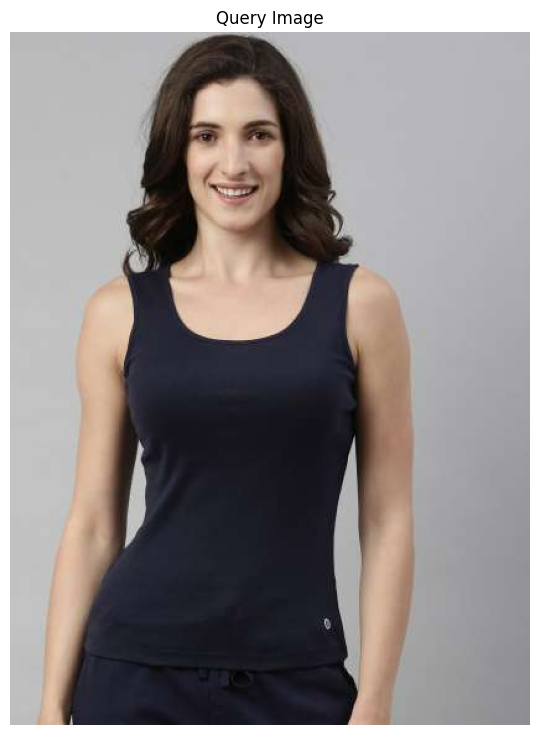

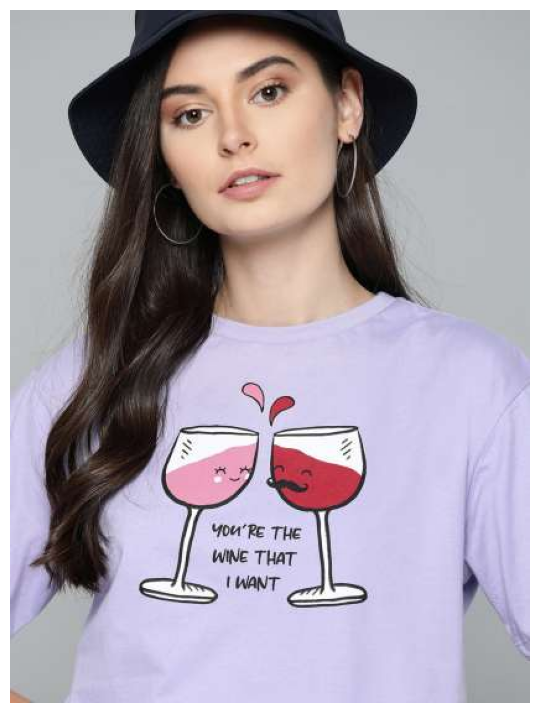

Shop Now @  https://www.myntra.com/tshirts/kook+n+keech/kook-n-keech-women-lavender--maroon-boxy-pure-cotton-wine-printed-round-neck-t-shirt/12959136/buy


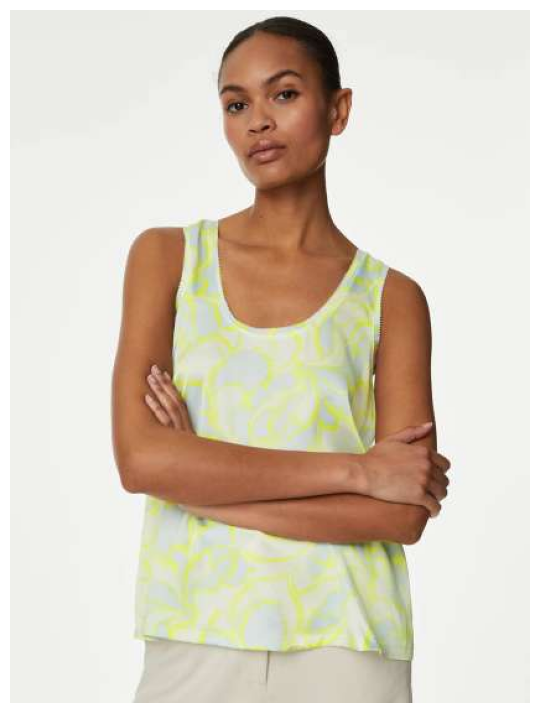

Shop Now @  https://www.myntra.com/tops/marks+%26+spencer/marks--spencer-abstract-printed-shoulder-straps-top/25678346/buy


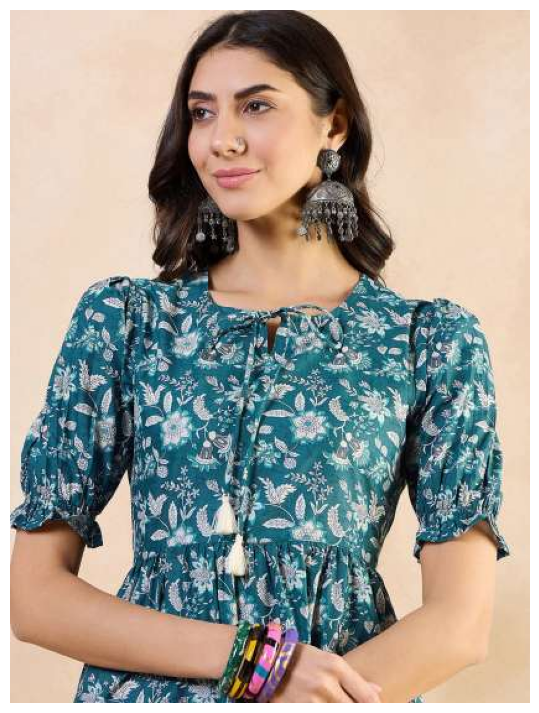

Shop Now @  https://www.myntra.com/dresses/anouk/anouk-tie-up-neck-floral-printed-cotton-a-line-dress/29454356/buy


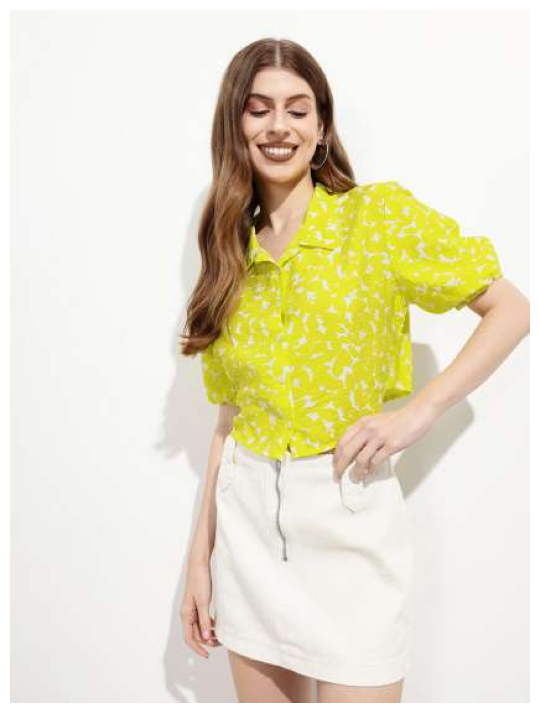

Shop Now @  https://www.myntra.com/shirts/dressberry/dressberry-cyberlime-hyperbrights-abstract-blaze-crop-shirt/28191194/buy


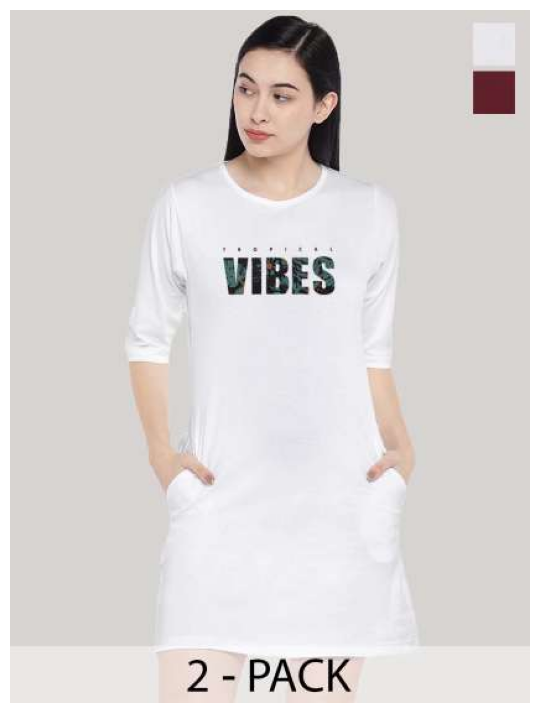

Shop Now @  https://www.myntra.com/dresses/status+mantra/status-mantra-pack-of-2-typography-printed-cotton-t-shirt-dress/29574344/buy


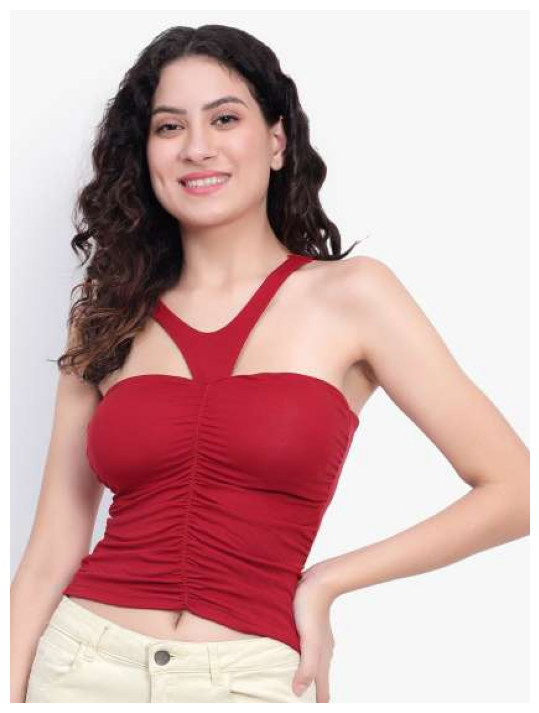

Shop Now @  https://www.myntra.com/tops/brachy/brachy-sleeveless-ruched-fitted-top/25564196/buy


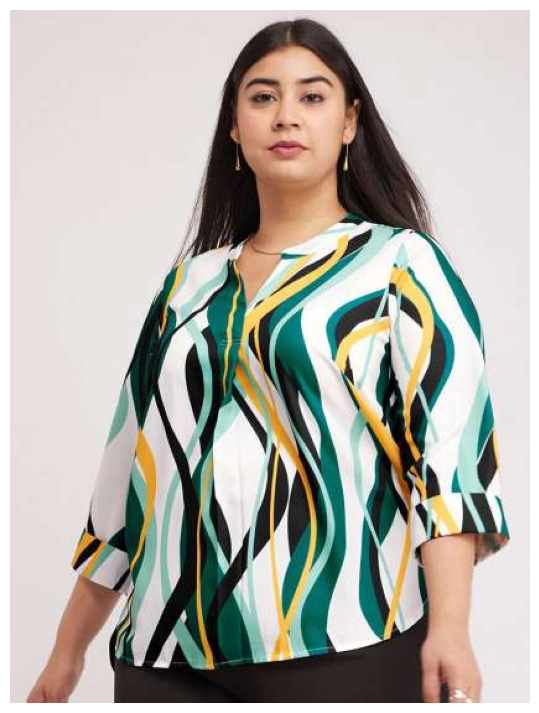

Shop Now @  https://www.myntra.com/tops/fablestreet+x/fablestreet-x-plus-size-abstract-printed-mandarin-collar-three-quarter-sleeves-top/27015508/buy


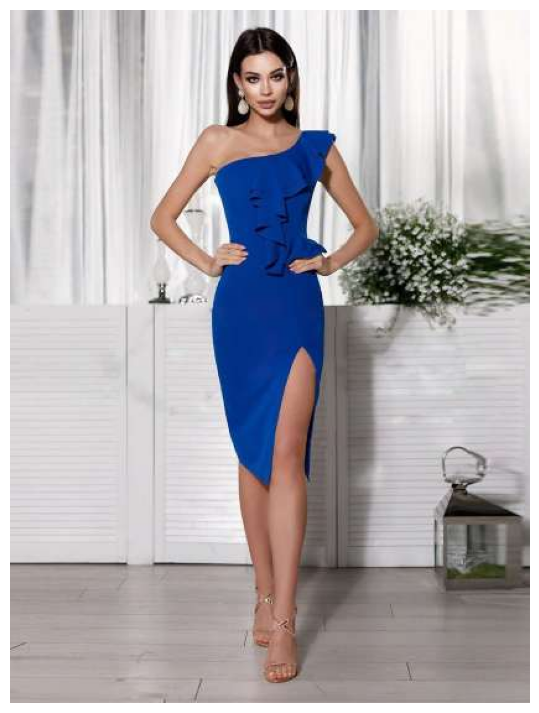

Shop Now @  https://www.myntra.com/dresses/stylecast+x+revolte/stylecast-x-revolte-one-shoulder-ruffles-cotton-bodycon-dress/28417124/buy


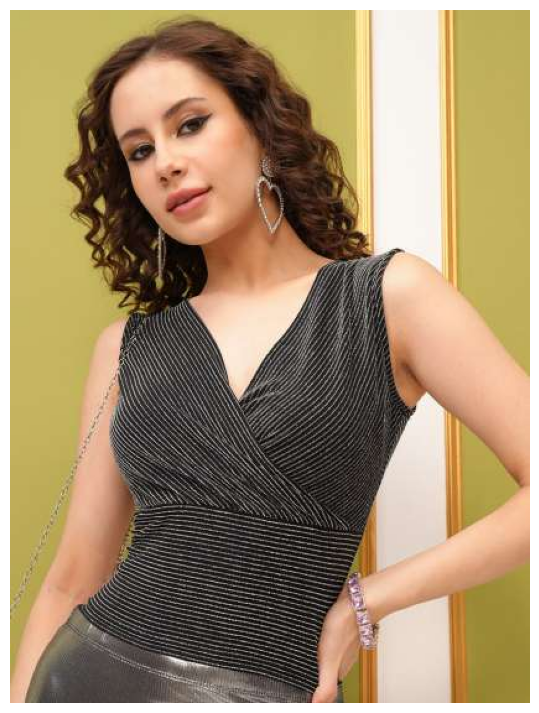

Shop Now @  https://www.myntra.com/tops/tokyo+talkies/tokyo-talkies-black-v-neck-striped-wrap-top/29058752/buy


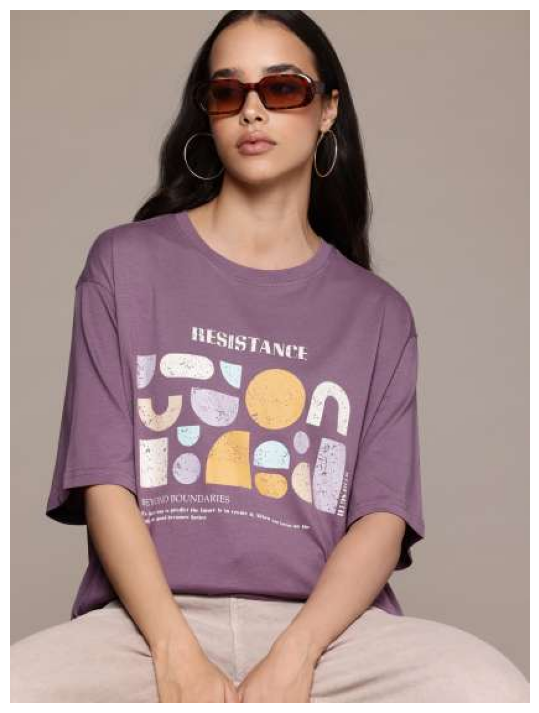

Shop Now @  https://www.myntra.com/tshirts/roadster/the-roadster-lifestyle-co-printed-pure-cotton-oversized-t-shirt/28174732/buy


In [72]:
import requests
from io import BytesIO
from PIL import Image
import matplotlib.pyplot as plt
from skimage import io

tqdm.pandas()

# Randomly select an embedding as the query
query_embedding = womens_topwear.iloc[random.randint(0, womens_topwear.shape[0])].embedding

# Calculate distances between the query embedding and other embeddings
womens_topwear['distance'] = womens_topwear['embedding'].progress_apply(
    lambda x: np.linalg.norm(np.asarray(eval(x), dtype=np.float32) - np.asarray(eval(query_embedding), dtype=np.float32))
)

# Sort by distance
womens_topwear = womens_topwear.sort_values(by='distance').reset_index(drop=True)

# Display the query image
plt.figure(figsize=(16,9))

# Download and display the image from the URL
response = requests.get(womens_topwear.iloc[0].image_url)
image = Image.open(BytesIO(response.content))
plt.imshow(image)
plt.title("Query Image")
plt.axis("off")
plt.show()

print(254 * "=")
print(254 * "=")

# Display the top 10 similar images
for i, row in womens_topwear.iloc[1:11].iterrows():
    plt.figure(figsize=(16,9))
    
    # Download and display the image from the URL
    response = requests.get(row["image_url"])
    image = Image.open(BytesIO(response.content))
    plt.imshow(image)
    plt.axis("off")
    plt.show()
    
    print("Shop Now @ ", row["product_url"])
    print(254 * "=")


In [73]:
womens_bottomwear = pd.read_csv("./downloaded_scrapped_data_embeddings/womens_bottomwear_embeddings.csv")

100%|██████████| 1712/1712 [00:03<00:00, 523.17it/s]


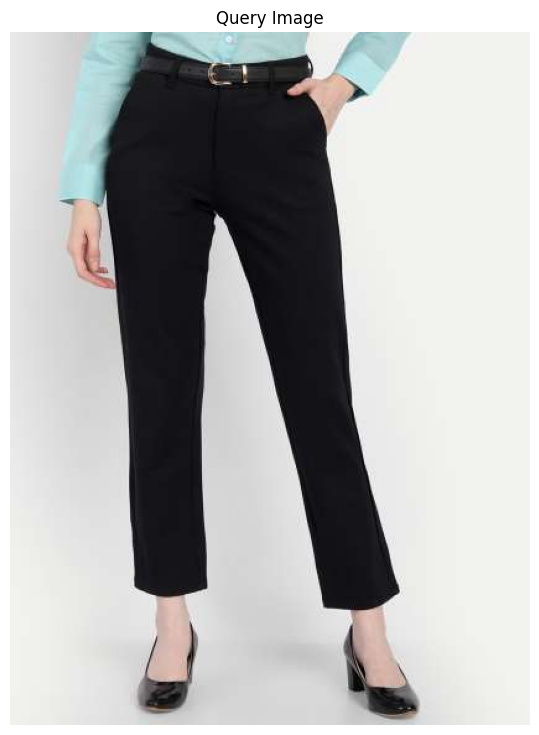

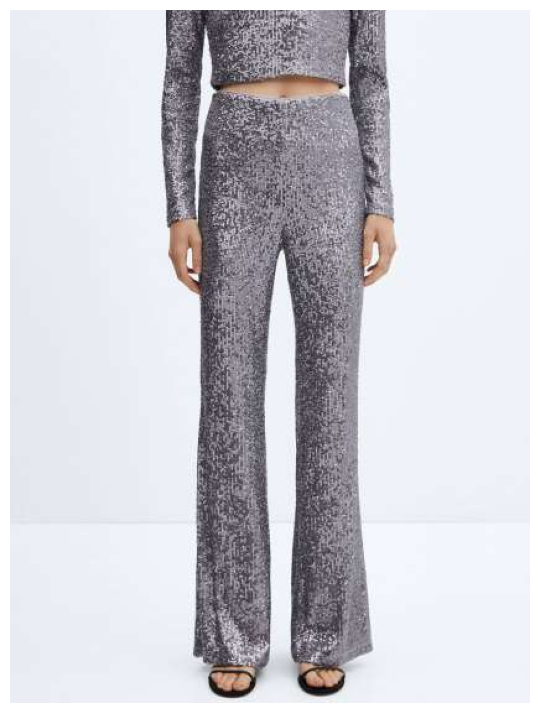

Shop Now @  https://www.myntra.com/trousers/mango/mango-women-sequinned-party-trousers/25377078/buy


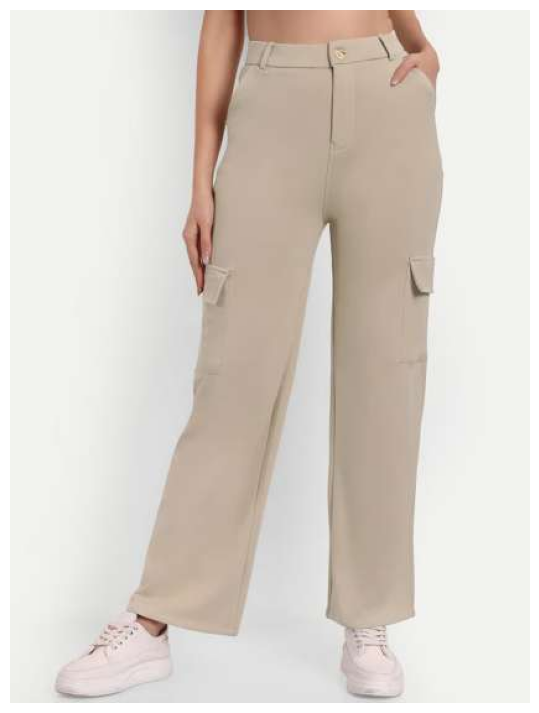

Shop Now @  https://www.myntra.com/trousers/baesd/baesd-women-relaxed-high-rise-non-iron-organiccotton-cargo-trousers/28413400/buy


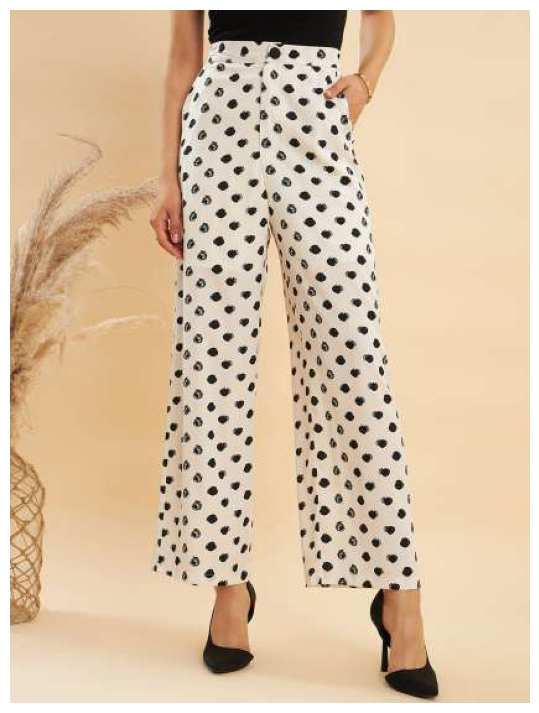

Shop Now @  https://www.myntra.com/trousers/kassually/kassually-women-black-polka-dot-printed-straight-fit-parallel-trousers/23972630/buy


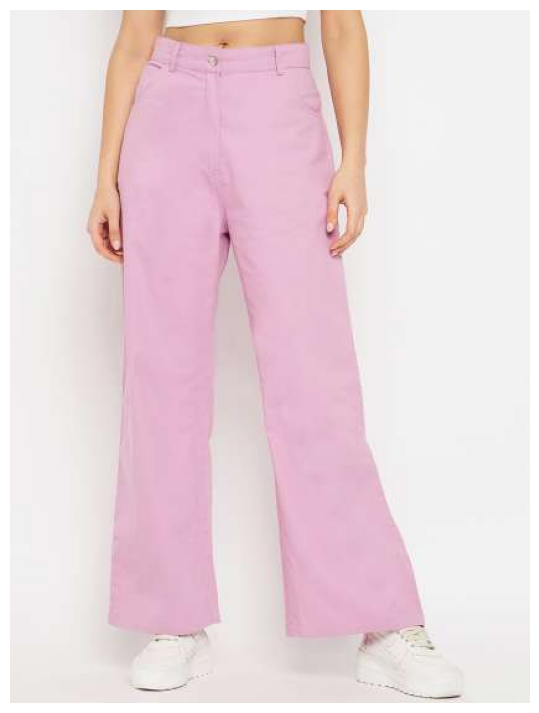

Shop Now @  https://www.myntra.com/trousers/orchid+blues/orchid-blues-women-flared-high-rise-pure-cotton-easy-wash-trousers/21865924/buy


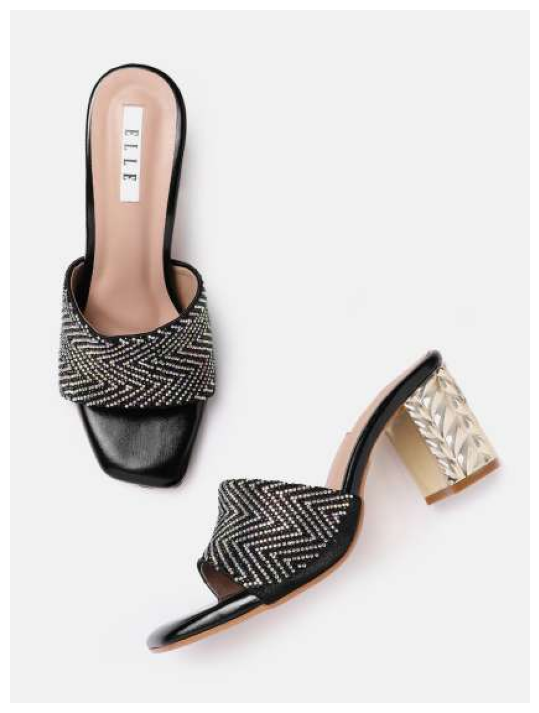

Shop Now @  https://www.myntra.com/heels/elle/elle-women-embellished-party-block-heels/22722008/buy


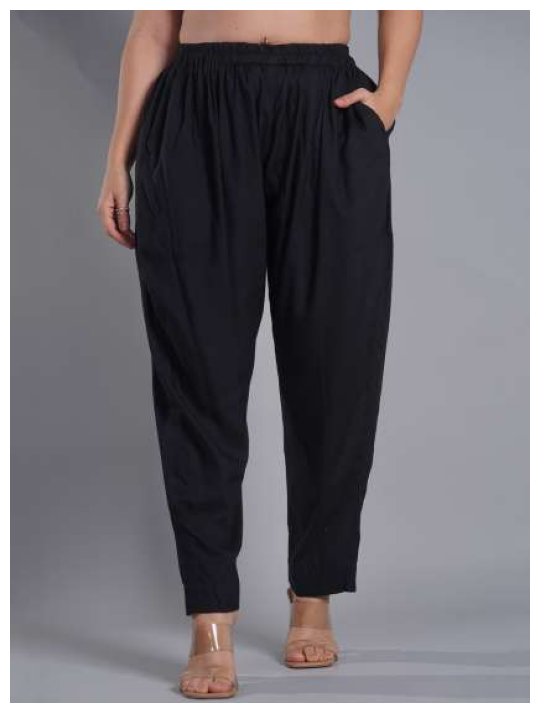

Shop Now @  https://www.myntra.com/trousers/letsdressup/letsdressup-women-mid-rise-casual-trouser/28624470/buy


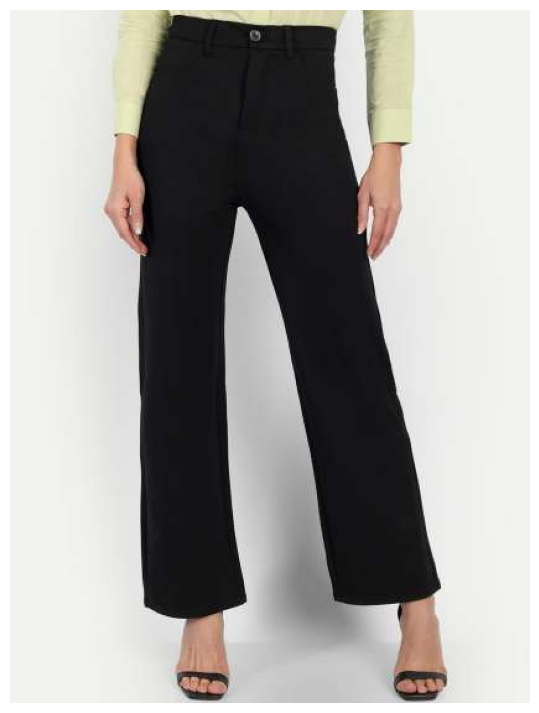

Shop Now @  https://www.myntra.com/trousers/next+one/next-one-women-smart-straight-fit-high-rise-formal-trousers/23704822/buy


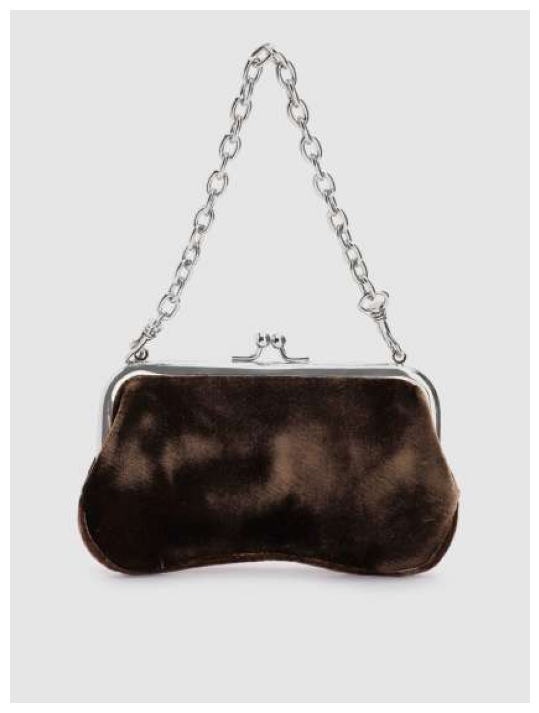

Shop Now @  https://www.myntra.com/clutches/mango/mango-women-velvety-finish-party-purse-/26411934/buy


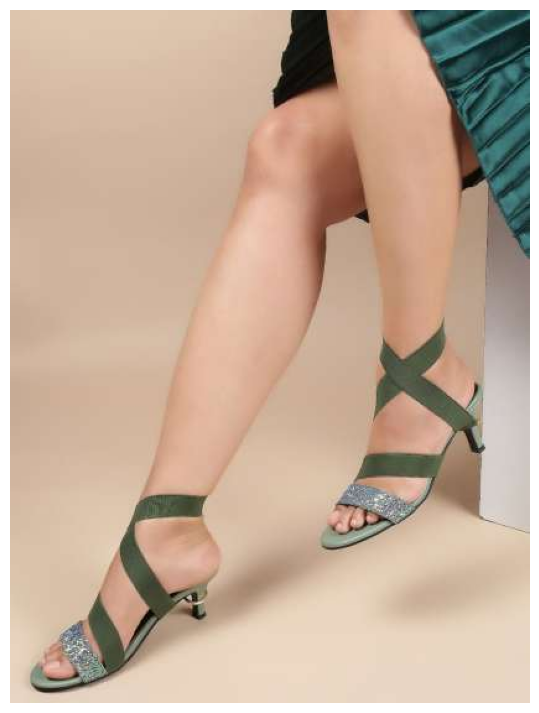

Shop Now @  https://www.myntra.com/heels/monrow/monrow-women-colourblocked-pu-party-diy-gladiator-heels/18656430/buy


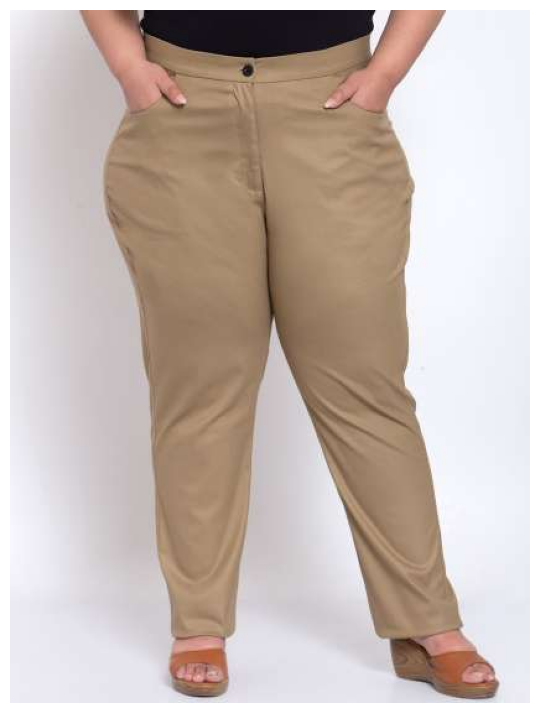

Shop Now @  https://www.myntra.com/trousers/pluss/pluss-women-beige-regular-fit-cotton-solid-formal-trousers/14142126/buy


In [74]:
tqdm.pandas()

# Randomly select an embedding as the query
query_embedding = womens_bottomwear.iloc[random.randint(0, womens_bottomwear.shape[0])].embedding

# Calculate distances between the query embedding and other embeddings
womens_bottomwear['distance'] = womens_bottomwear['embedding'].progress_apply(
    lambda x: np.linalg.norm(np.asarray(eval(x), dtype=np.float32) - np.asarray(eval(query_embedding), dtype=np.float32))
)

# Sort by distance
womens_bottomwear = womens_bottomwear.sort_values(by='distance').reset_index(drop=True)

# Display the query image
plt.figure(figsize=(16,9))

# Download and display the image from the URL
response = requests.get(womens_bottomwear.iloc[0].image_url)
image = Image.open(BytesIO(response.content))
plt.imshow(image)
plt.title("Query Image")
plt.axis("off")
plt.show()

print(254 * "=")
print(254 * "=")

# Display the top 10 similar images
for i, row in womens_bottomwear.iloc[1:11].iterrows():
    plt.figure(figsize=(16,9))
    
    # Download and display the image from the URL
    response = requests.get(row["image_url"])
    image = Image.open(BytesIO(response.content))
    plt.imshow(image)
    plt.axis("off")
    plt.show()
    
    print("Shop Now @ ", row["product_url"])
    print(254 * "=")


In [75]:
womens_footwear = pd.read_csv("./downloaded_scrapped_data_embeddings/womens_footwear_embeddings.csv")

100%|██████████| 1834/1834 [00:03<00:00, 513.76it/s]


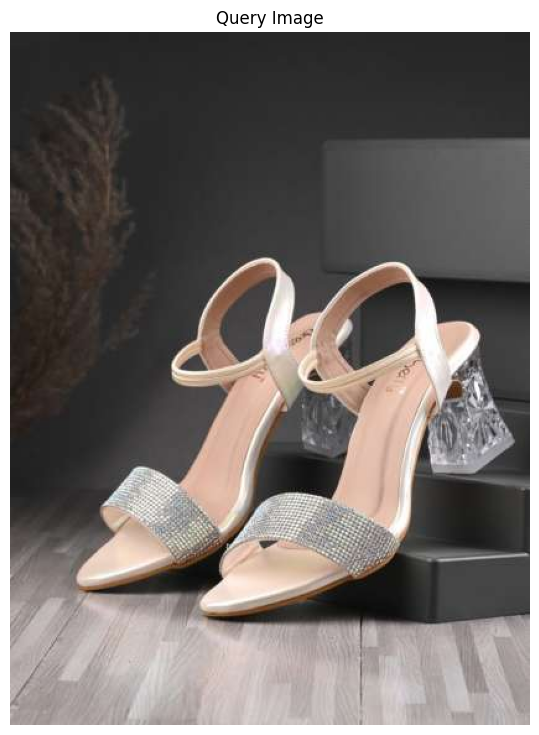

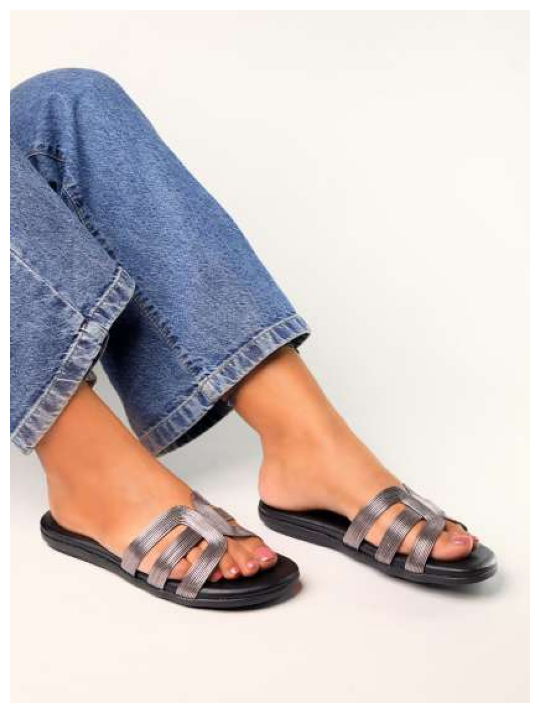

Shop Now @  https://www.myntra.com/flats/monrow/monrow-ariana-textured-open-toe-flats/23988174/buy


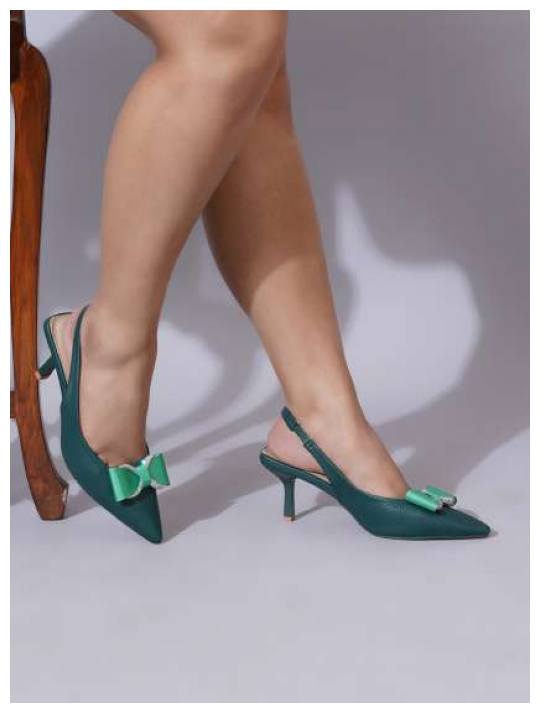

Shop Now @  https://www.myntra.com/heels/sherrif+shoes/sherrif-shoes-textured-pu-party-block-pumps-with-buckles/29908615/buy


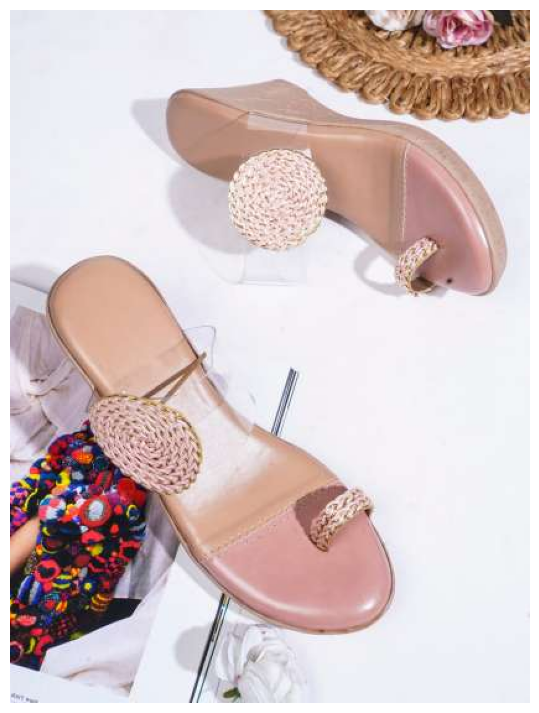

Shop Now @  https://www.myntra.com/heels/try+me/try-me-embellished-party-block-with-bows/29658266/buy


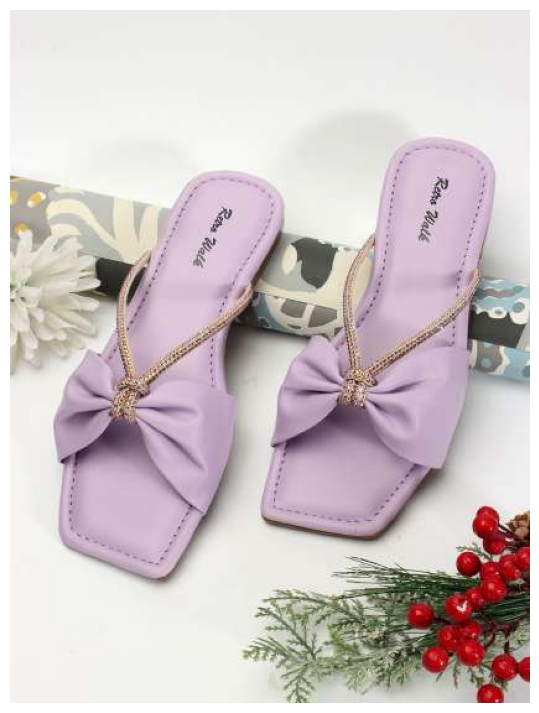

Shop Now @  https://www.myntra.com/flats/retro+walk/retro-walk-bow-embellished-open-toe-flats/24199332/buy


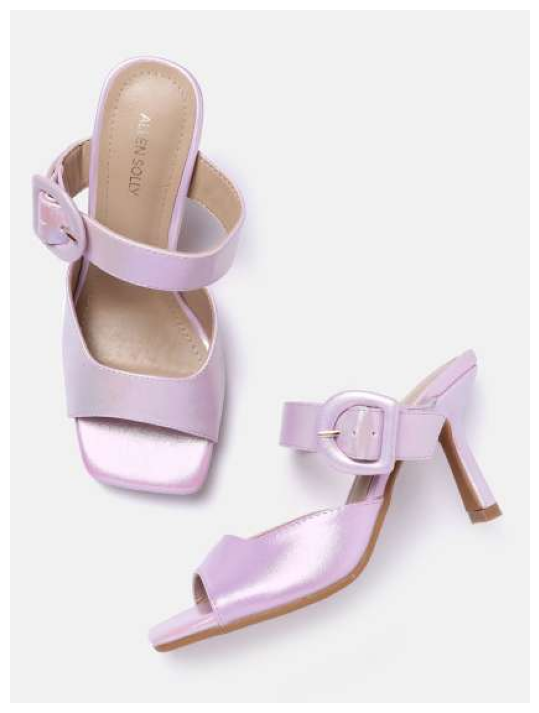

Shop Now @  https://www.myntra.com/heels/allen+solly/allen-solly-buckle-detail-open-toe-slim-heels-with-sheen-effect/25423474/buy


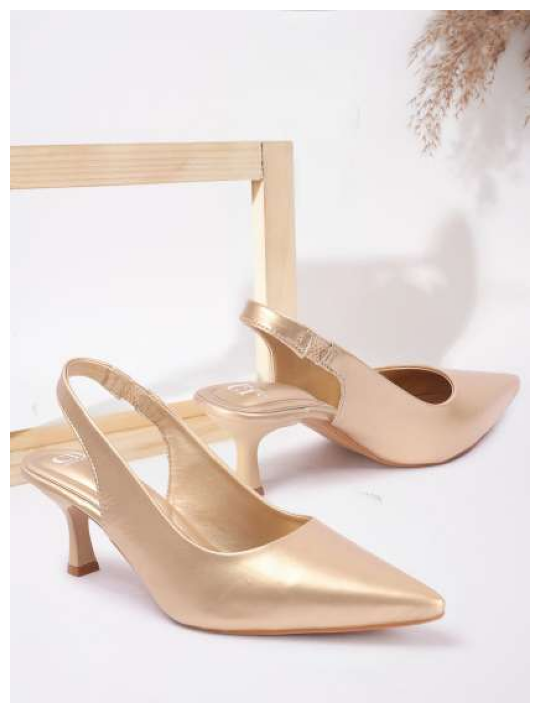

Shop Now @  https://www.myntra.com/heels/carlton+london/carlton-london-slim-heeled-mules/29552794/buy


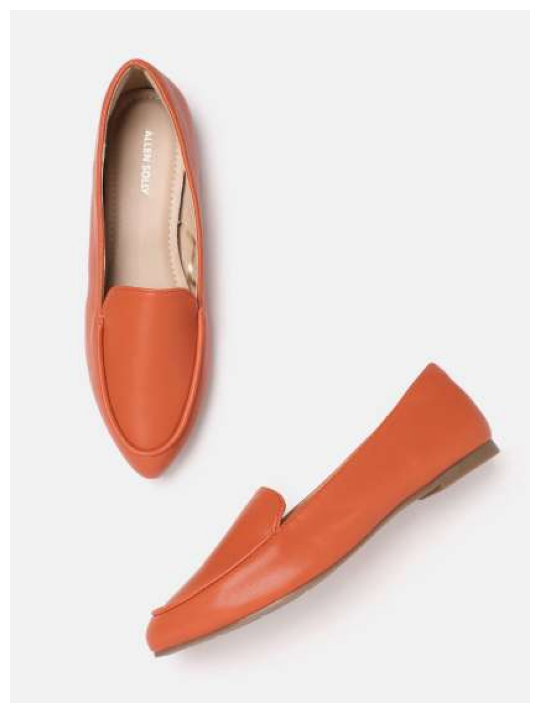

Shop Now @  https://www.myntra.com/flats/allen+solly/allen-solly-women-pointed-toe-ballerinas-/27464162/buy


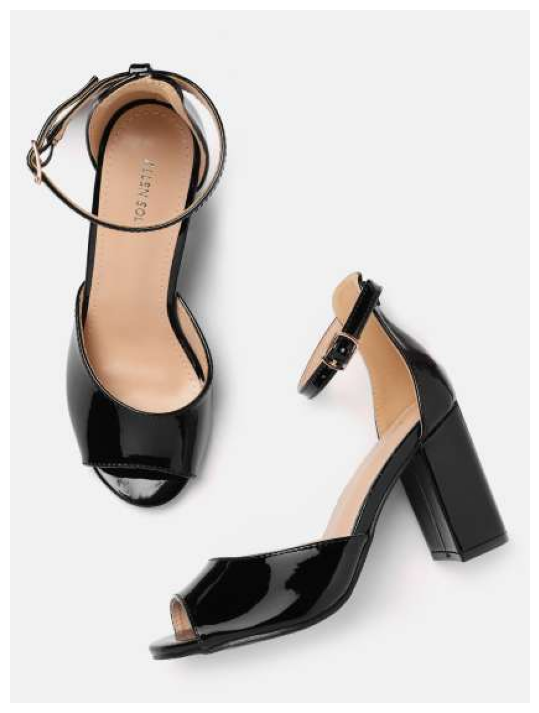

Shop Now @  https://www.myntra.com/heels/allen+solly/allen-solly-glossy-block-heels/27464148/buy


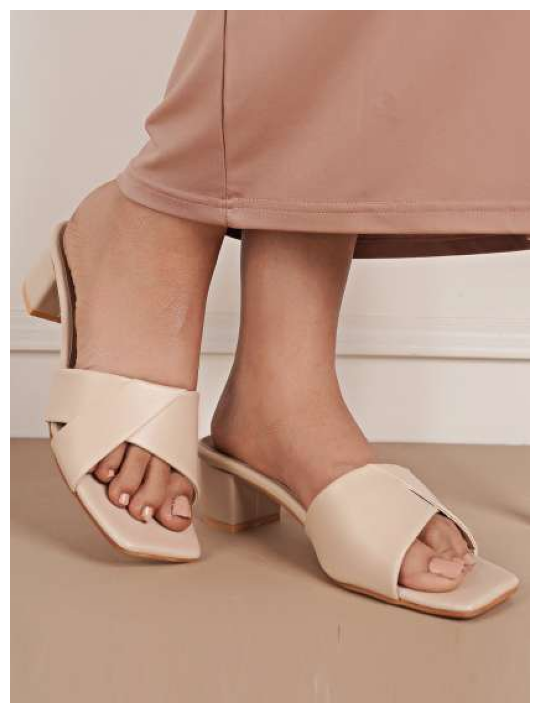

Shop Now @  https://www.myntra.com/heels/mast+%26+harbour/mast--harbour-cream-coloured-open-toe-block-heels/23124874/buy


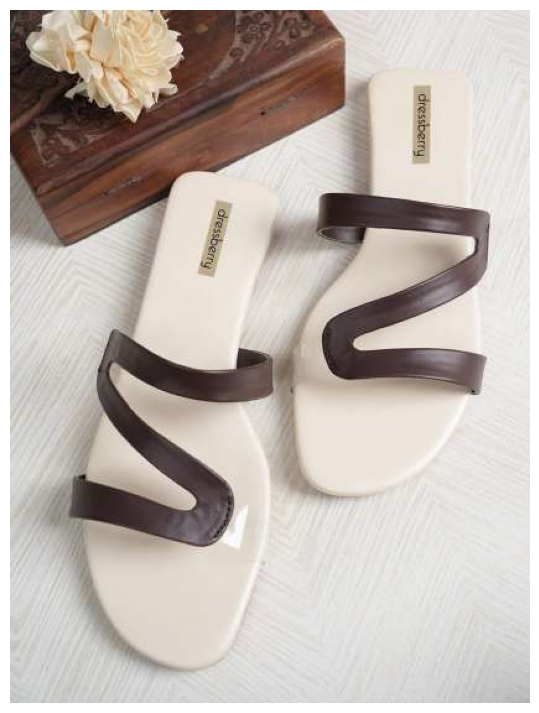

Shop Now @  https://www.myntra.com/flats/dressberry/dressberry-brown-open-toe-flats/29930796/buy


In [76]:
tqdm.pandas()

# Randomly select an embedding as the query
query_embedding = womens_footwear.iloc[random.randint(0, womens_footwear.shape[0])].embedding

# Calculate distances between the query embedding and other embeddings
womens_footwear['distance'] = womens_footwear['embedding'].progress_apply(
    lambda x: np.linalg.norm(np.asarray(eval(x), dtype=np.float32) - np.asarray(eval(query_embedding), dtype=np.float32))
)

# Sort by distance
womens_footwear = womens_footwear.sort_values(by='distance').reset_index(drop=True)

# Display the query image
plt.figure(figsize=(16,9))

# Download and display the image from the URL
response = requests.get(womens_footwear.iloc[0].image_url)
image = Image.open(BytesIO(response.content))
plt.imshow(image)
plt.title("Query Image")
plt.axis("off")
plt.show()

print(254 * "=")
print(254 * "=")

# Display the top 10 similar images
for i, row in womens_footwear.iloc[1:11].iterrows():
    plt.figure(figsize=(16,9))
    
    # Download and display the image from the URL
    response = requests.get(row["image_url"])
    image = Image.open(BytesIO(response.content))
    plt.imshow(image)
    plt.axis("off")
    plt.show()
    
    print("Shop Now @ ", row["product_url"])
    print(254 * "=")


In [77]:
womens_eyewear = pd.read_csv("./downloaded_scrapped_data_embeddings/womens_eyewear_embeddings.csv")

100%|██████████| 708/708 [00:01<00:00, 533.57it/s]


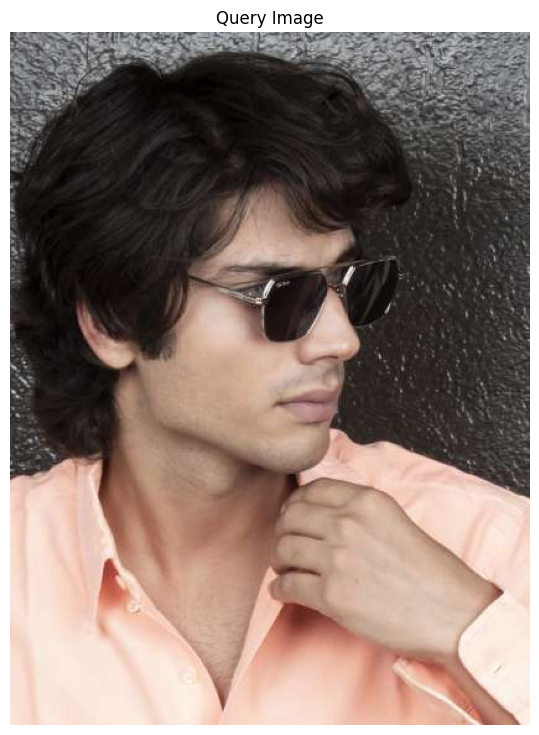

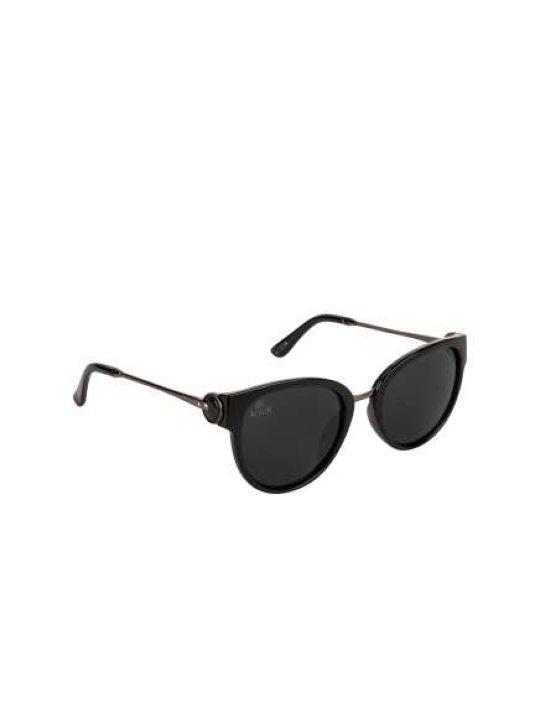

Shop Now @  https://www.myntra.com/sunglasses/aislin/aislin-women-black-uv-protected-cateye-sunglasses-es14485-82-as-8334/13902404/buy


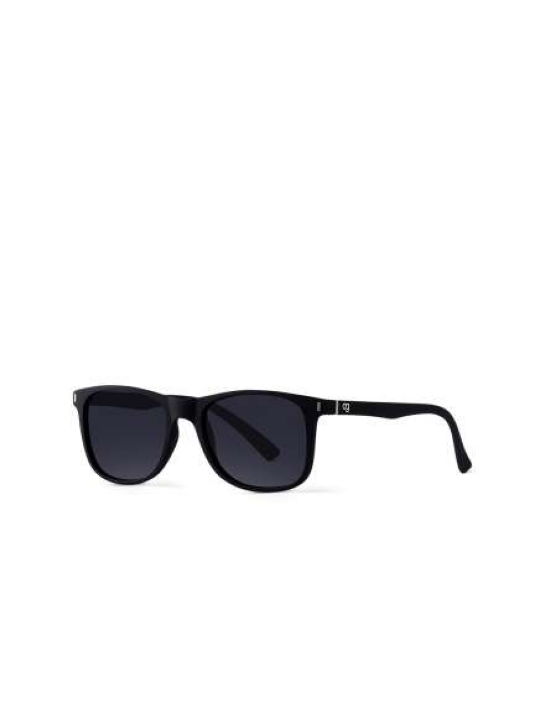

Shop Now @  https://www.myntra.com/sunglasses/woggles/woggles-unisex-square-sunglasses-with-polarised-lens/29649090/buy


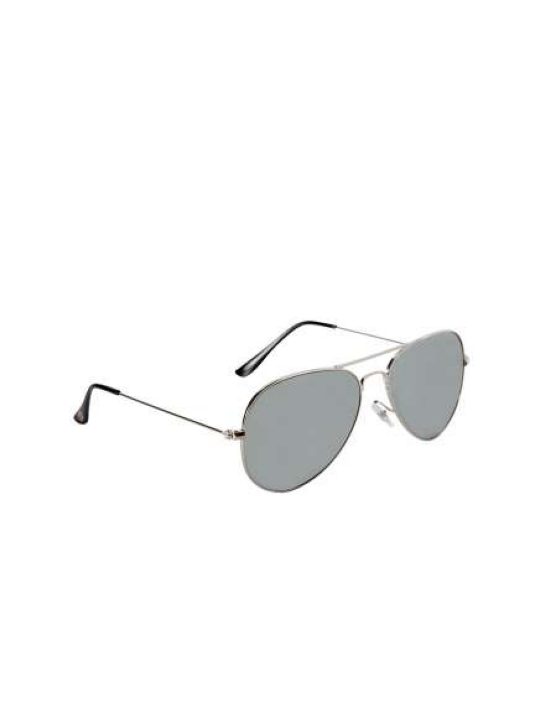

Shop Now @  https://www.myntra.com/sunglasses/gio+collection/gio-collection-unisex-green-uv-protected-aviator-sunglasses-gm3025c04/15362882/buy


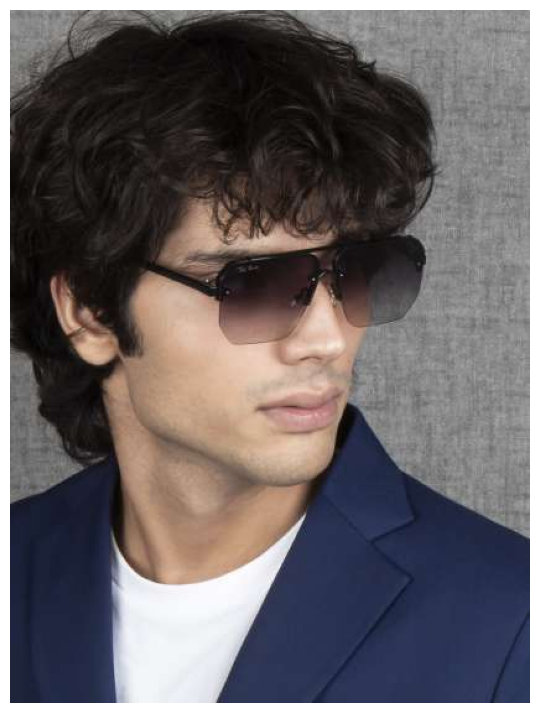

Shop Now @  https://www.myntra.com/sunglasses/ted+smith/ted-smith-aviator-sunglasses-with-polarised-and-uv-protected-lens/21697062/buy


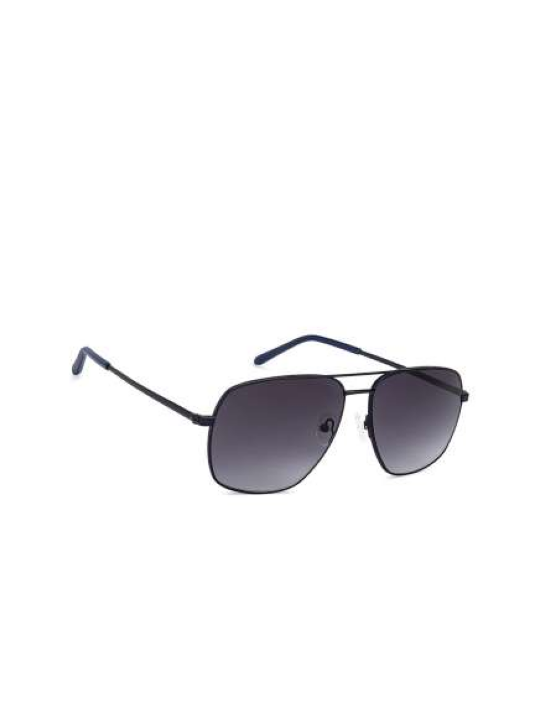

Shop Now @  https://www.myntra.com/sunglasses/john+jacobs/john-jacobs-unisex-grey-lens--blue-square-sunglasses-with-uv-protected-lens/18909786/buy


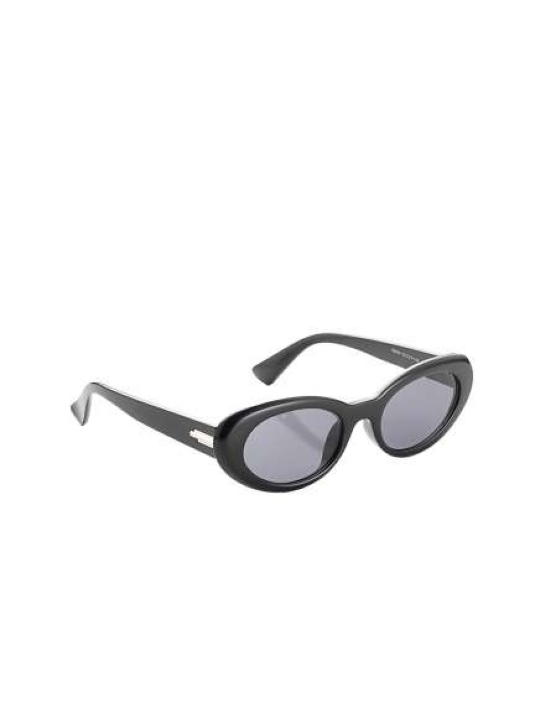

Shop Now @  https://www.myntra.com/sunglasses/hashtag+eyewear/hashtag-eyewear-women-cateye-sunglass-with-uv-protected-lens-58030-c1/28546262/buy


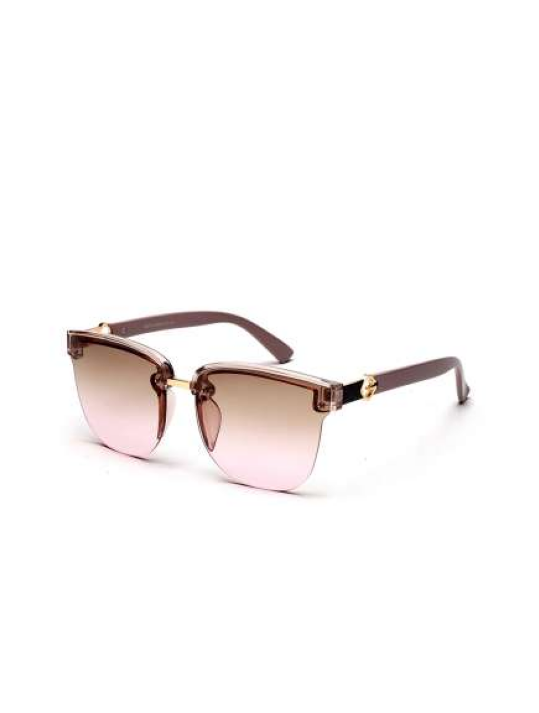

Shop Now @  https://www.myntra.com/sunglasses/yourspex/yourspex-unisex-brown-lens--brown-other-sunglasses-with-uv-protected-lens/19263960/buy


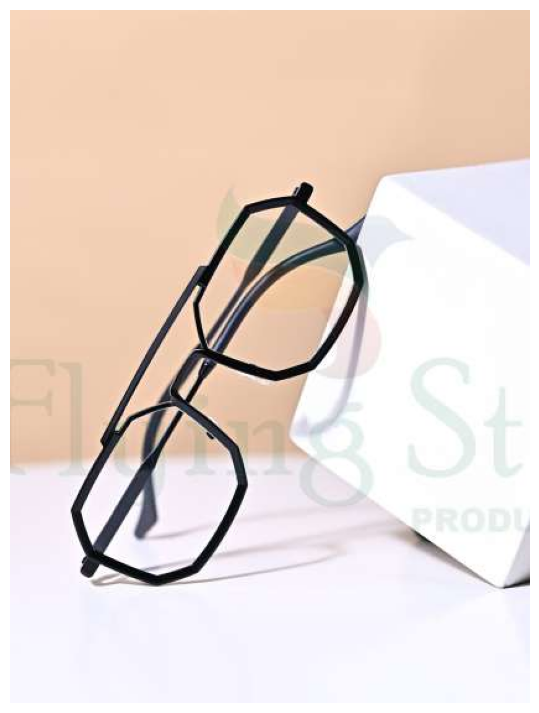

Shop Now @  https://www.myntra.com/sunglasses/aligatorr/aligatorr-unisex-sunglasses-with-uv-protected-lens-agrblkmaybk/25405266/buy


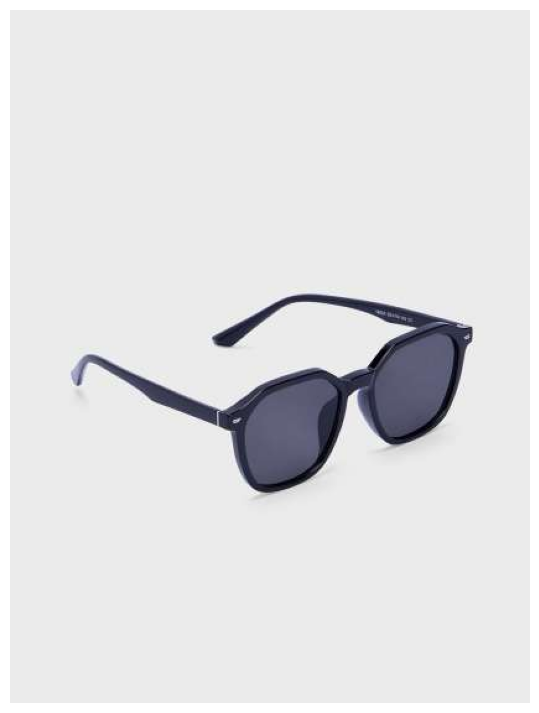

Shop Now @  https://www.myntra.com/sunglasses/20dresses/20dresses-women-oversized-sunglasses-sg011012/28512444/buy


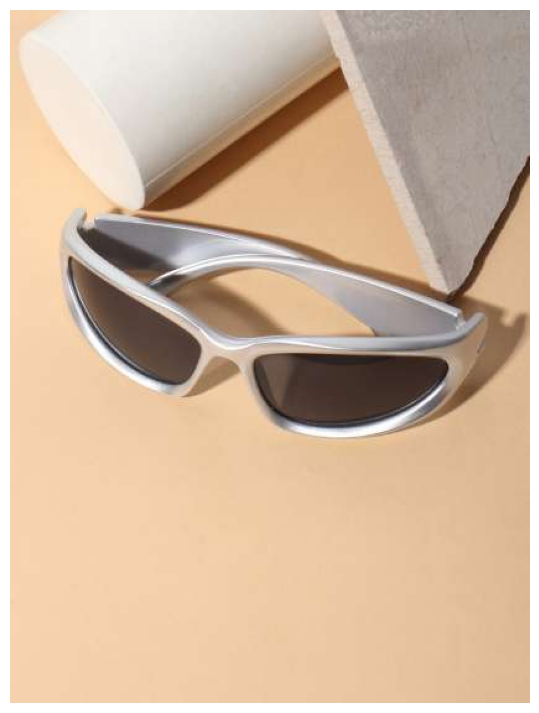

Shop Now @  https://www.myntra.com/sunglasses/dressberry/dressberry-women-oval-sunglasses-with-uv-protected-lens/24044552/buy


In [78]:
tqdm.pandas()

# Randomly select an embedding as the query
query_embedding = womens_eyewear.iloc[random.randint(0, womens_eyewear.shape[0])].embedding

# Calculate distances between the query embedding and other embeddings
womens_eyewear['distance'] = womens_eyewear['embedding'].progress_apply(
    lambda x: np.linalg.norm(np.asarray(eval(x), dtype=np.float32) - np.asarray(eval(query_embedding), dtype=np.float32))
)

# Sort by distance
womens_eyewear = womens_eyewear.sort_values(by='distance').reset_index(drop=True)

# Display the query image
plt.figure(figsize=(16,9))

# Download and display the image from the URL
response = requests.get(womens_eyewear.iloc[0].image_url)
image = Image.open(BytesIO(response.content))
plt.imshow(image)
plt.title("Query Image")
plt.axis("off")
plt.show()

print(254 * "=")
print(254 * "=")

# Display the top 10 similar images
for i, row in womens_eyewear.iloc[1:11].iterrows():
    plt.figure(figsize=(16,9))
    
    # Download and display the image from the URL
    response = requests.get(row["image_url"])
    image = Image.open(BytesIO(response.content))
    plt.imshow(image)
    plt.axis("off")
    plt.show()
    
    print("Shop Now @ ", row["product_url"])
    print(254 * "=")


In [79]:
mens_topwear = pd.read_csv("./downloaded_scrapped_data_embeddings/mens_topwear_embeddings.csv")

100%|██████████| 1738/1738 [00:03<00:00, 517.03it/s]


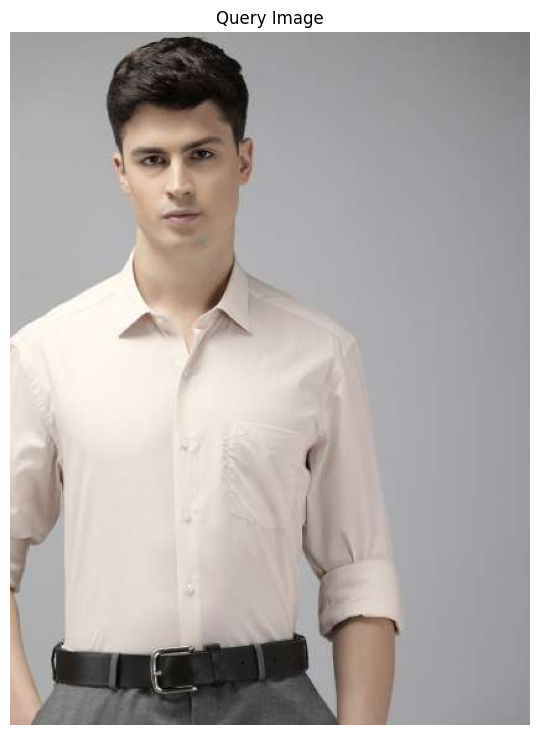

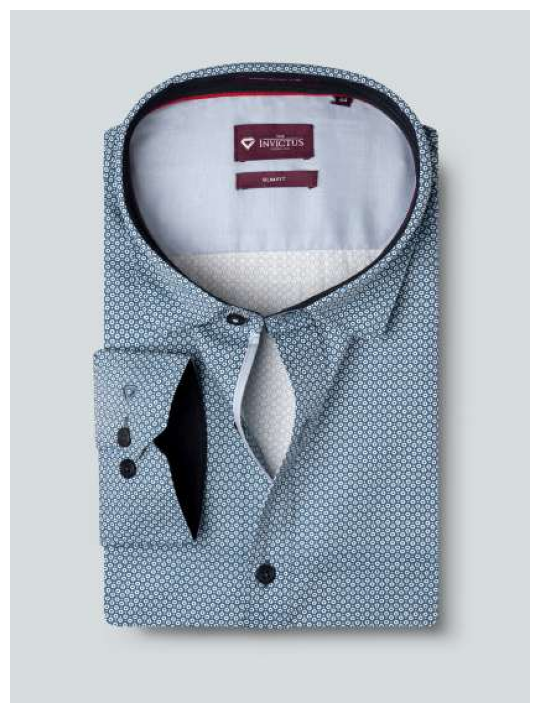

Shop Now @  https://www.myntra.com/shirts/invictus/invictus-men-blue--white-slim-fit-printed-smart-sustainable-casual-shirt/1674590/buy


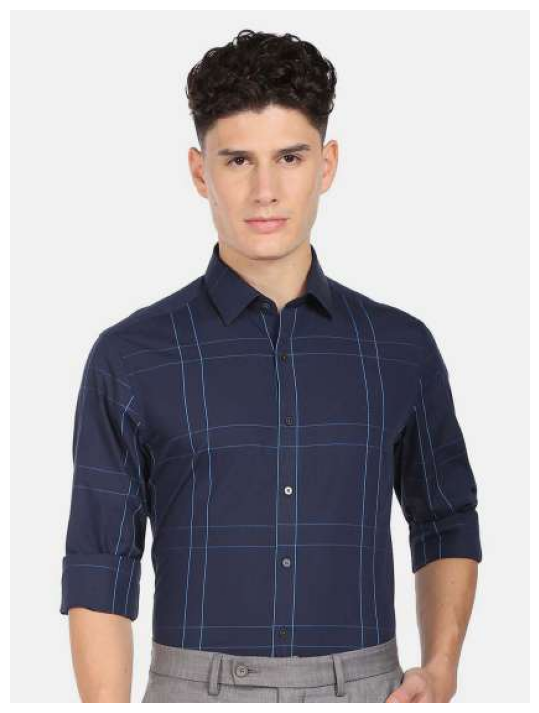

Shop Now @  https://www.myntra.com/shirts/arrow/arrow-slim-fit-windowpane-checks-checked-pure-cotton-formal-shirt/22112258/buy


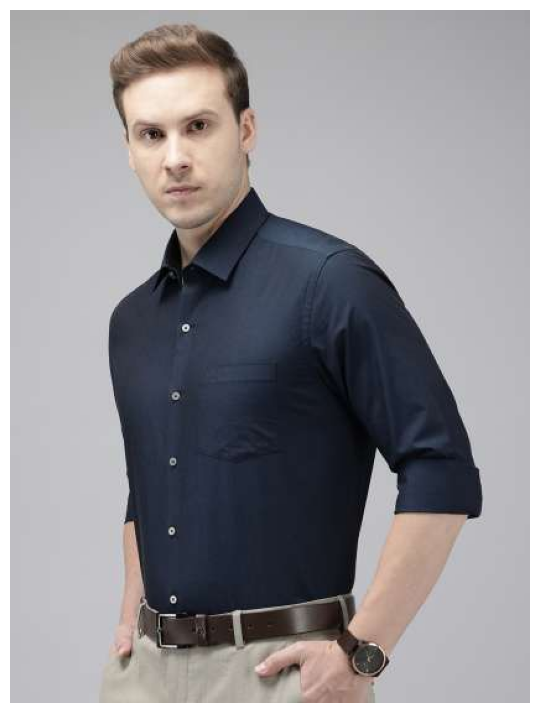

Shop Now @  https://www.myntra.com/shirts/arrow/arrow-pure-cotton-manhattan-slim-fit-formal-shirt/25989666/buy


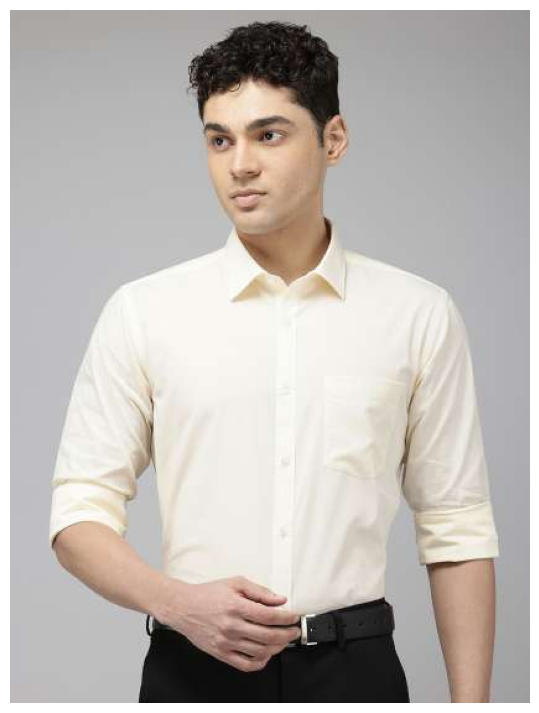

Shop Now @  https://www.myntra.com/shirts/park+avenue/park-avenue-slim-fit-cutaway-collar-pure-cotton-formal-shirt/27396024/buy


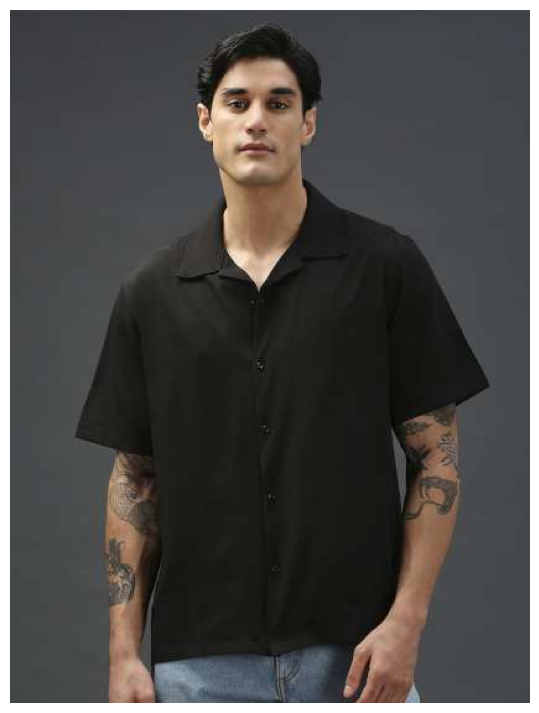

Shop Now @  https://www.myntra.com/shirts/vibe+the+hype/vibe-the-hype-men-relaxed-opaque-party-shirt/29949223/buy


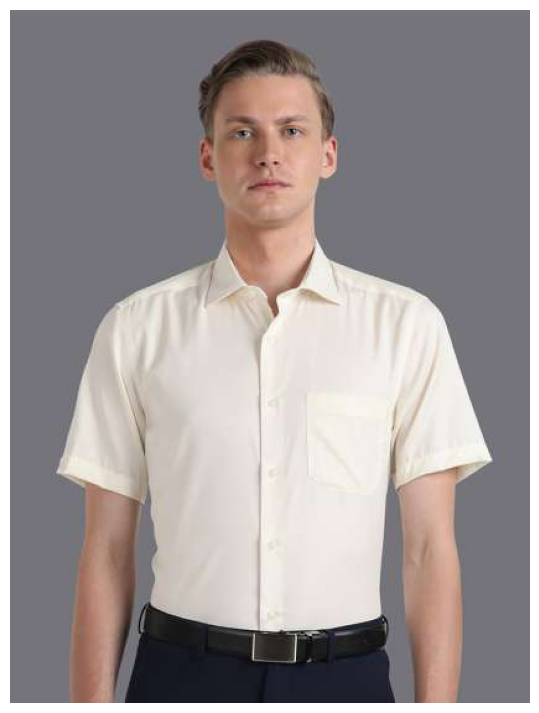

Shop Now @  https://www.myntra.com/shirts/louis+philippe/louis-philippe-slim-fit-pure-cotton-formal-shirt/23606716/buy


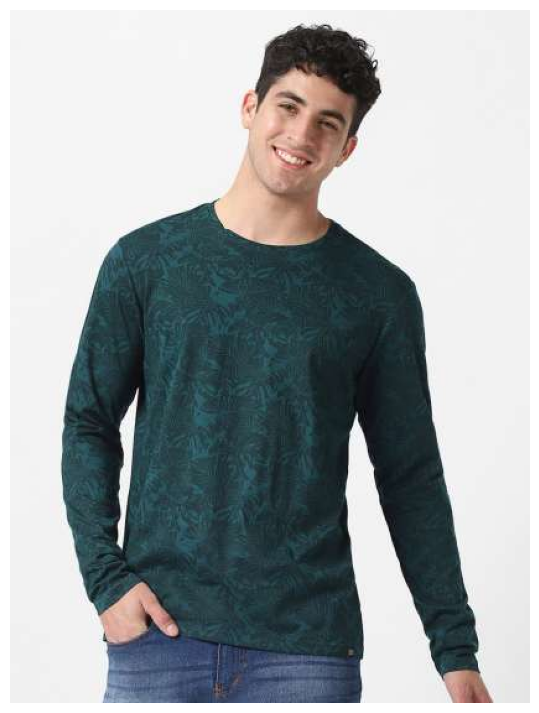

Shop Now @  https://www.myntra.com/tshirts/urbano+fashion/urbano-fashion-men-teal-green-slim-fit-tropical-printed-pure-cotton-t-shirt/12377258/buy


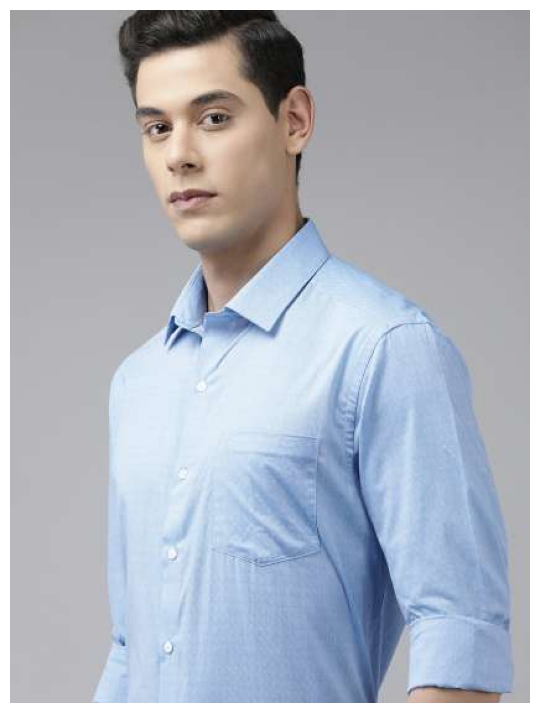

Shop Now @  https://www.myntra.com/shirts/arrow/arrow-men-blue-manhattan-slim-fit-textured-opaque-self-design-pure-cotton-formal-shirt/20308556/buy


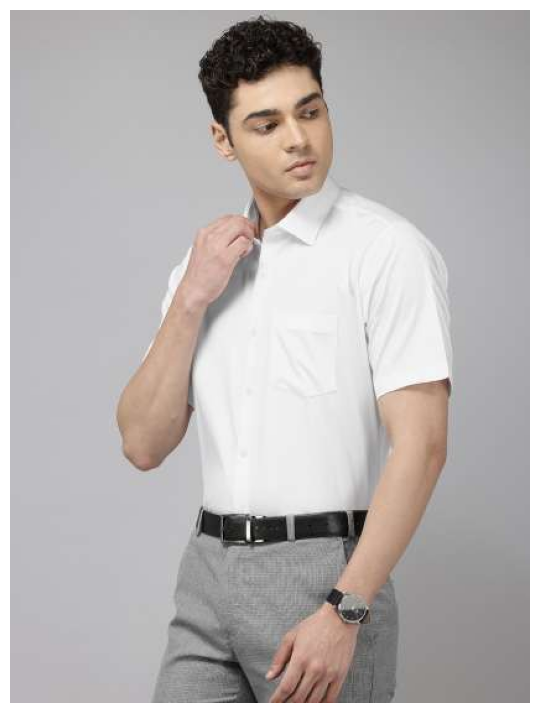

Shop Now @  https://www.myntra.com/shirts/van+heusen/van-heusen-custom-fit-formal-shirt/29711584/buy


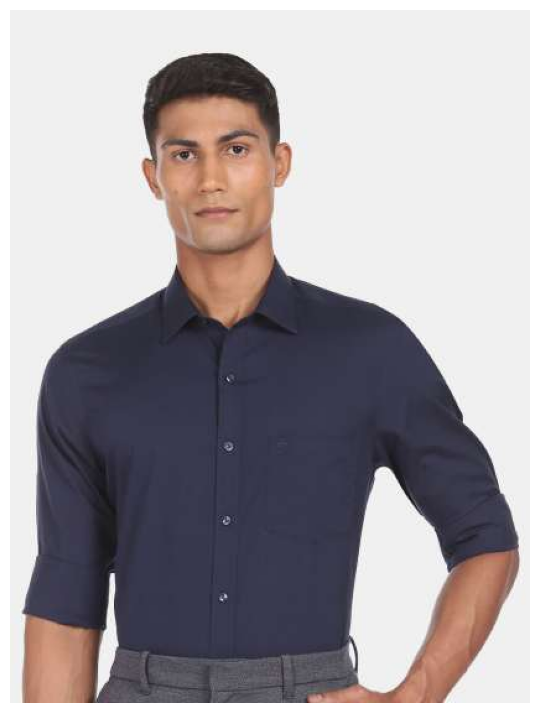

Shop Now @  https://www.myntra.com/shirts/arrow/arrow-men-pure-cotton-regular-fit-formal-shirt/21112384/buy


In [81]:
tqdm.pandas()

# Randomly select an embedding as the query
query_embedding = mens_topwear.iloc[random.randint(0, mens_topwear.shape[0])].embedding

# Calculate distances between the query embedding and other embeddings
mens_topwear['distance'] = mens_topwear['embedding'].progress_apply(
    lambda x: np.linalg.norm(np.asarray(eval(x), dtype=np.float32) - np.asarray(eval(query_embedding), dtype=np.float32))
)

# Sort by distance
mens_topwear = mens_topwear.sort_values(by='distance').reset_index(drop=True)

# Display the query image
plt.figure(figsize=(16,9))

# Download and display the image from the URL
response = requests.get(mens_topwear.iloc[0].image_url)
image = Image.open(BytesIO(response.content))
plt.imshow(image)
plt.title("Query Image")
plt.axis("off")
plt.show()

print(254 * "=")
print(254 * "=")

# Display the top 10 similar images
for i, row in mens_topwear.iloc[1:11].iterrows():
    plt.figure(figsize=(16,9))
    
    # Download and display the image from the URL
    response = requests.get(row["image_url"])
    image = Image.open(BytesIO(response.content))
    plt.imshow(image)
    plt.axis("off")
    plt.show()
    
    print("Shop Now @ ", row["product_url"])
    print(254 * "=")


In [82]:
mens_bottomwear = pd.read_csv("./downloaded_scrapped_data_embeddings/mens_bottomwear_embeddings.csv")

100%|██████████| 1814/1814 [00:03<00:00, 534.49it/s]


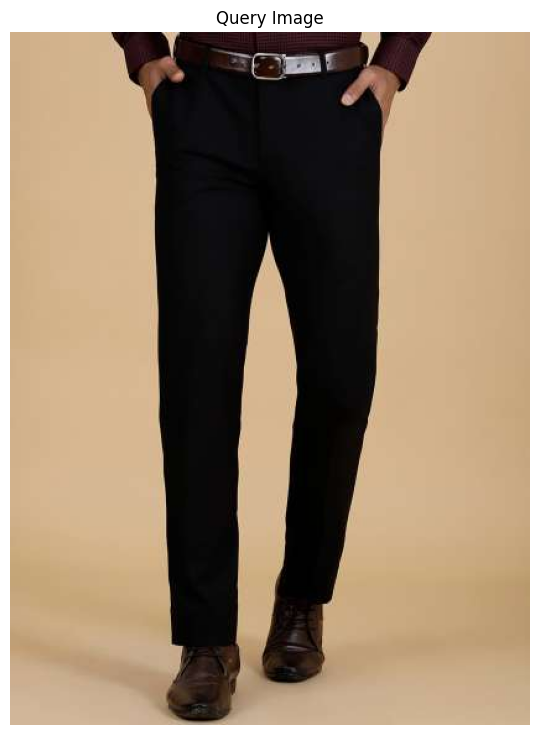

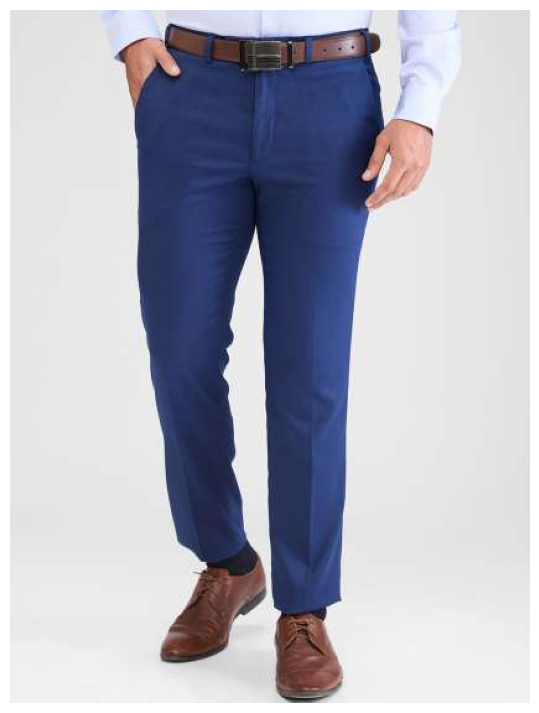

Shop Now @  https://www.myntra.com/trousers/park+avenue/park-avenue-men-slim-fit-trousers/29911363/buy


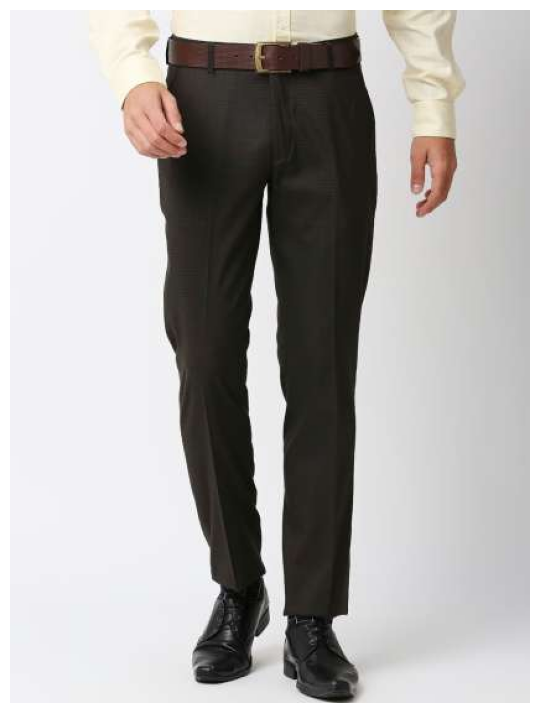

Shop Now @  https://www.myntra.com/trousers/solemio/solemio-men-slim-fit-formal-trousers/21791056/buy


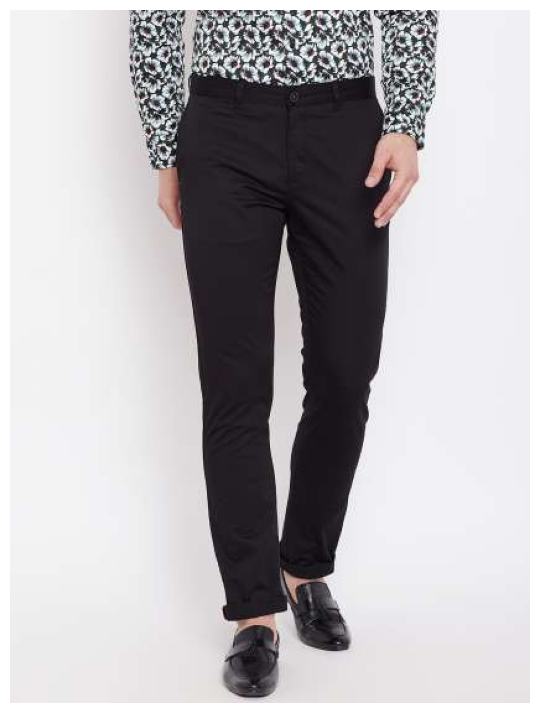

Shop Now @  https://www.myntra.com/trousers/blackberrys/blackberrys-men-black-slim-fit-solid-trousers/8031705/buy


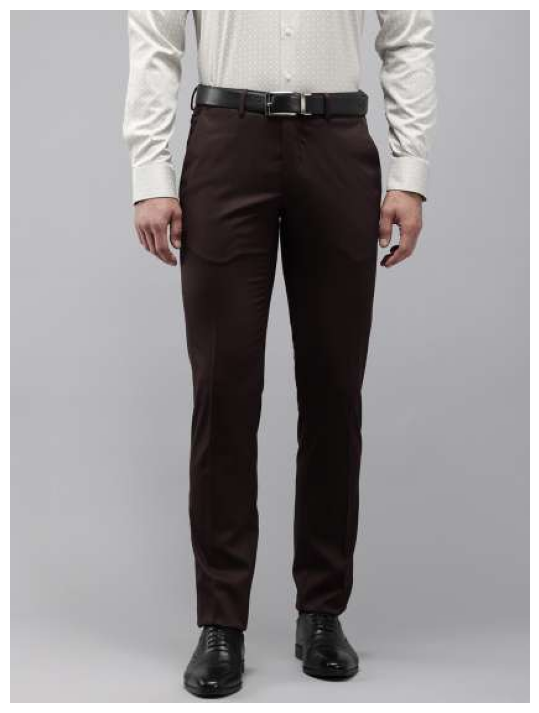

Shop Now @  https://www.myntra.com/trousers/van+heusen/van-heusen-men-ultra-slim-fit-formal-trousers/28386758/buy


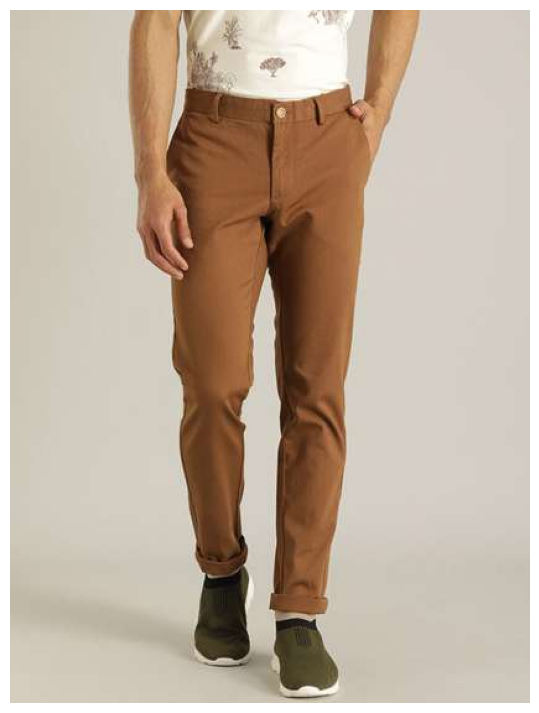

Shop Now @  https://www.myntra.com/trousers/indian+terrain/indian-terrain-men-brooklyn-mid-rise-plain-pure-cotton-slim-fit-chinos-trousers/23116830/buy


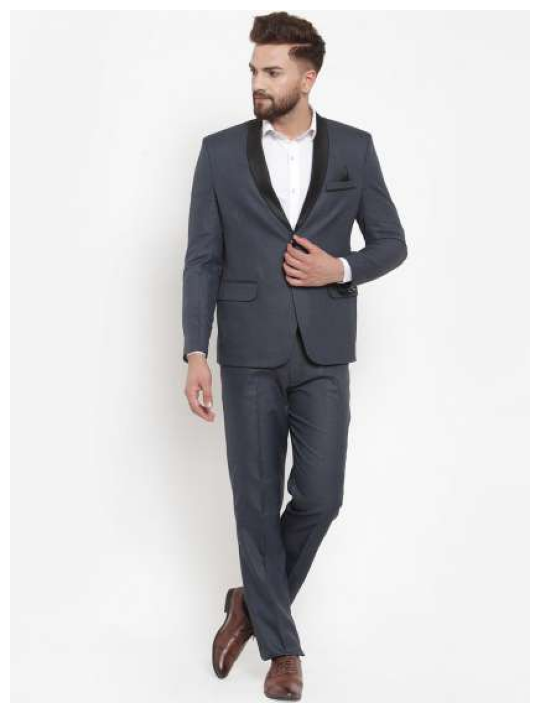

Shop Now @  https://www.myntra.com/suits/klotthe/klotthe-men-blue-solid-slim-fit-single-breasted-two-piece-party-suit/18160960/buy


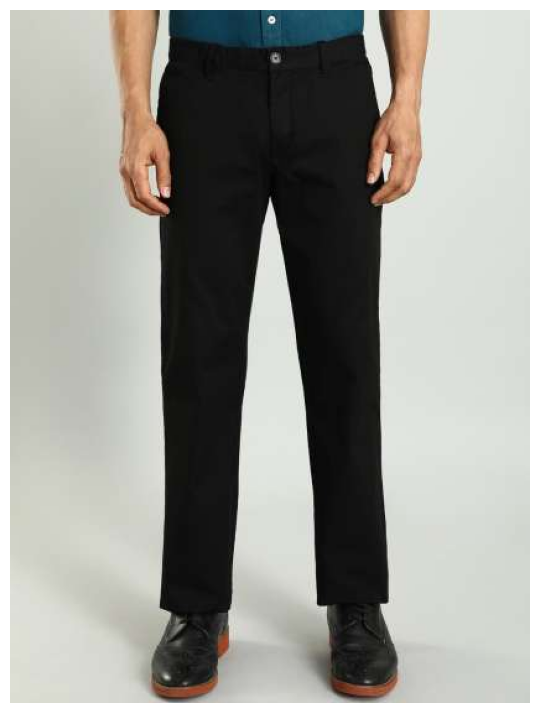

Shop Now @  https://www.myntra.com/trousers/indian+terrain/indian-terrain-men-kansas-mid-rise-chinos-trousers/29835947/buy


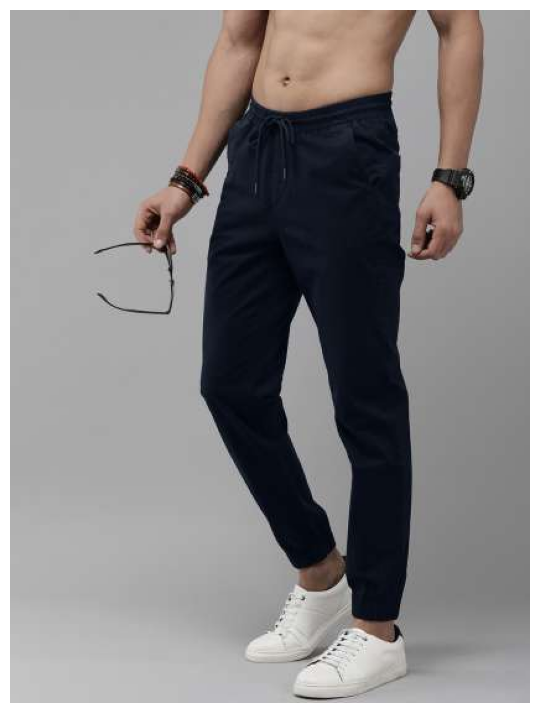

Shop Now @  https://www.myntra.com/trousers/roadster/the-roadster-life-co-men-mid-rise-joggers/21630884/buy


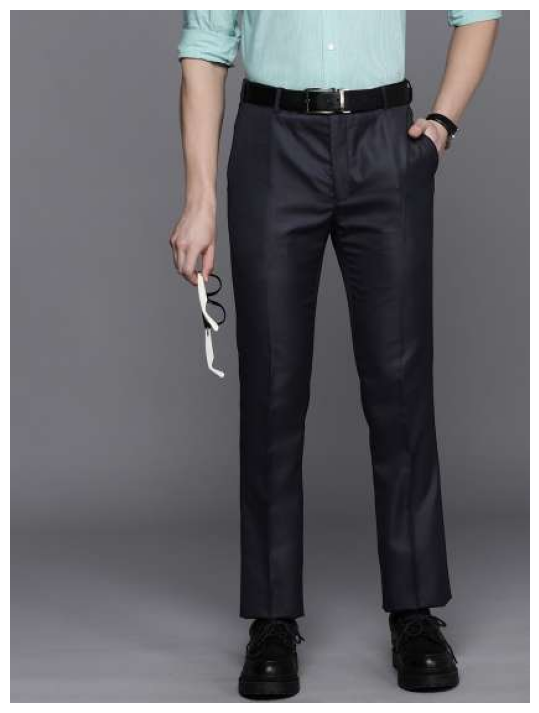

Shop Now @  https://www.myntra.com/trousers/raymond/raymond-men-textured-slim-fit-flat-front-formal-trousers/20325674/buy


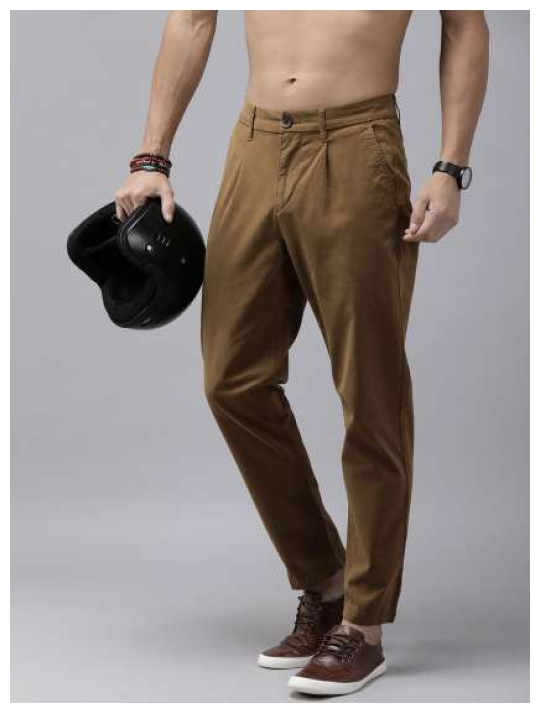

Shop Now @  https://www.myntra.com/trousers/roadster/the-roadster-lifestyle-co-men-solid-relaxed-fit-pleated-chinos-trousers/21641540/buy


In [83]:
tqdm.pandas()

# Randomly select an embedding as the query
query_embedding = mens_bottomwear.iloc[random.randint(0, mens_bottomwear.shape[0])].embedding

# Calculate distances between the query embedding and other embeddings
mens_bottomwear['distance'] = mens_bottomwear['embedding'].progress_apply(
    lambda x: np.linalg.norm(np.asarray(eval(x), dtype=np.float32) - np.asarray(eval(query_embedding), dtype=np.float32))
)

# Sort by distance
mens_bottomwear = mens_bottomwear.sort_values(by='distance').reset_index(drop=True)

# Display the query image
plt.figure(figsize=(16,9))

# Download and display the image from the URL
response = requests.get(mens_bottomwear.iloc[0].image_url)
image = Image.open(BytesIO(response.content))
plt.imshow(image)
plt.title("Query Image")
plt.axis("off")
plt.show()

print(254 * "=")
print(254 * "=")

# Display the top 10 similar images
for i, row in mens_bottomwear.iloc[1:11].iterrows():
    plt.figure(figsize=(16,9))
    
    # Download and display the image from the URL
    response = requests.get(row["image_url"])
    image = Image.open(BytesIO(response.content))
    plt.imshow(image)
    plt.axis("off")
    plt.show()
    
    print("Shop Now @ ", row["product_url"])
    print(254 * "=")


In [84]:
mens_footwear = pd.read_csv("./downloaded_scrapped_data_embeddings/mens_footwear_embeddings.csv")

100%|██████████| 1837/1837 [00:03<00:00, 525.46it/s]


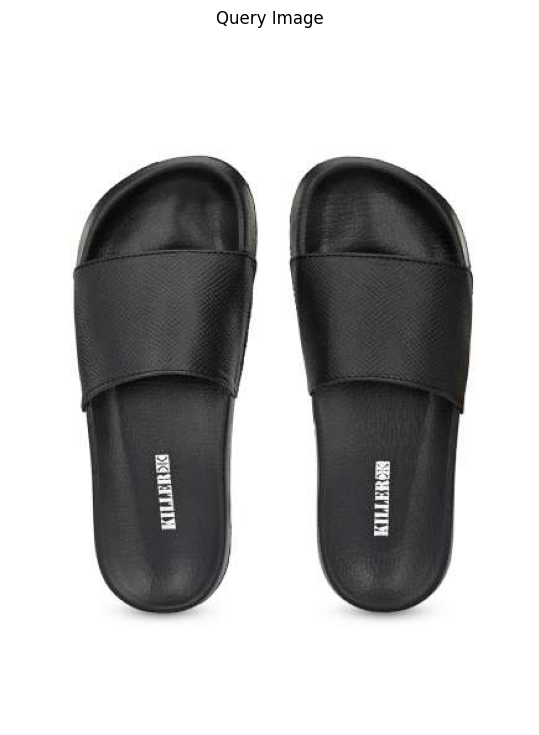

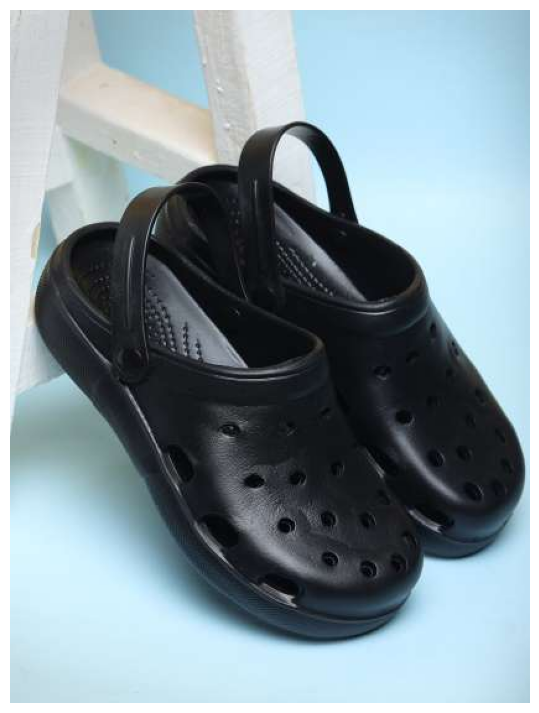

Shop Now @  https://www.myntra.com/flip-flops/greentech/greentech-men-slip-on-rubber-clogs/24500276/buy


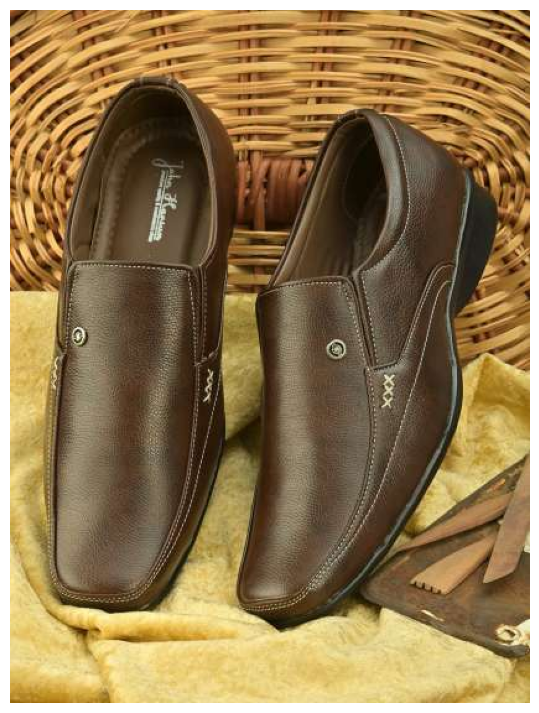

Shop Now @  https://www.myntra.com/formal-shoes/john+karsun/-john-karsun-men-brown-solid-slip-on-formal-shoes/19758270/buy


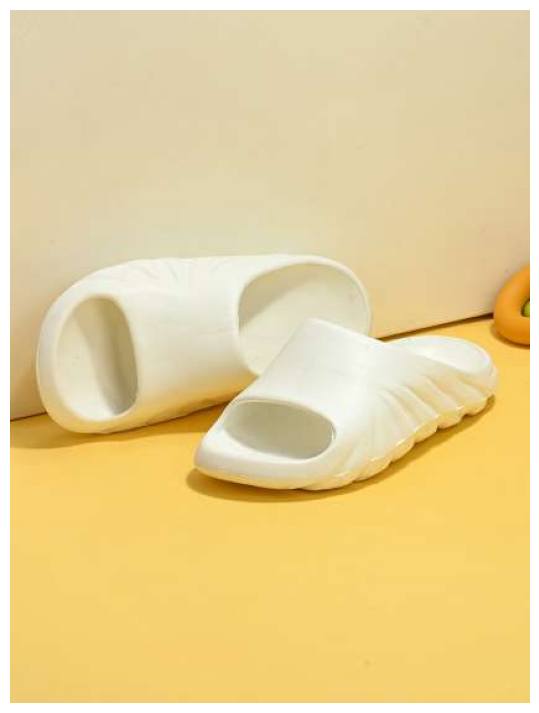

Shop Now @  https://www.myntra.com/flip-flops/afrojack/afrojack-men-croslite-sliders/21999412/buy


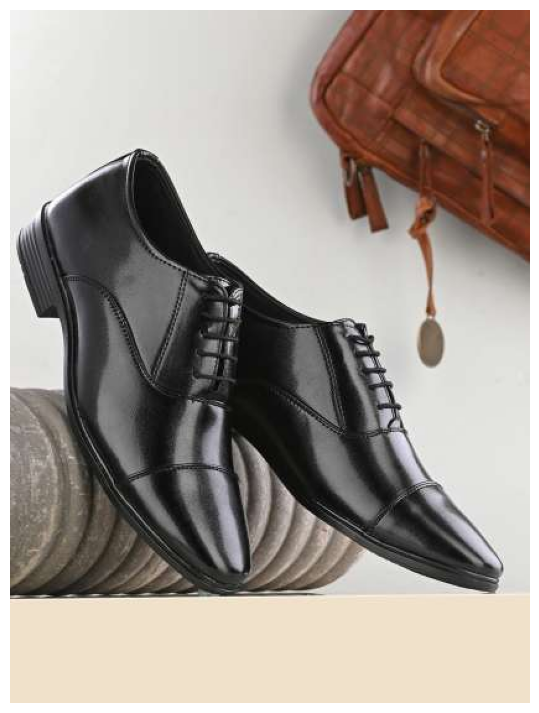

Shop Now @  https://www.myntra.com/formal-shoes/invictus/invictus-men-formal-oxfords/25338924/buy


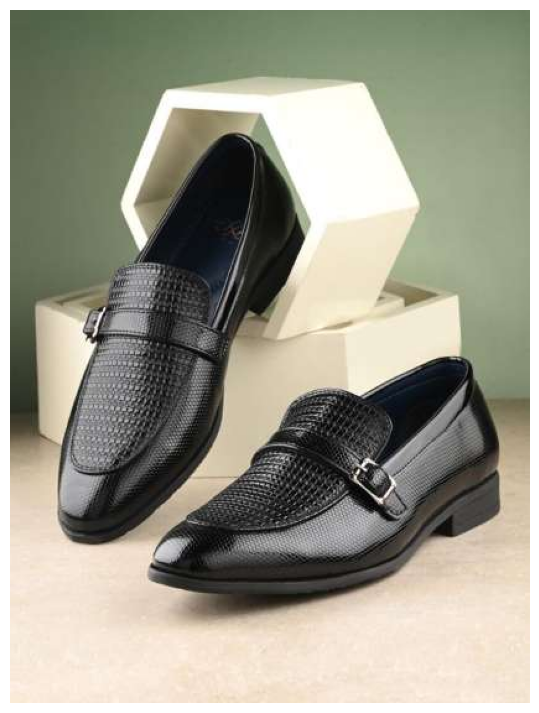

Shop Now @  https://www.myntra.com/formal-shoes/house+of+pataudi/house-of-pataudi-men-textured-buckled-formal-slip-on-loafers/26731112/buy


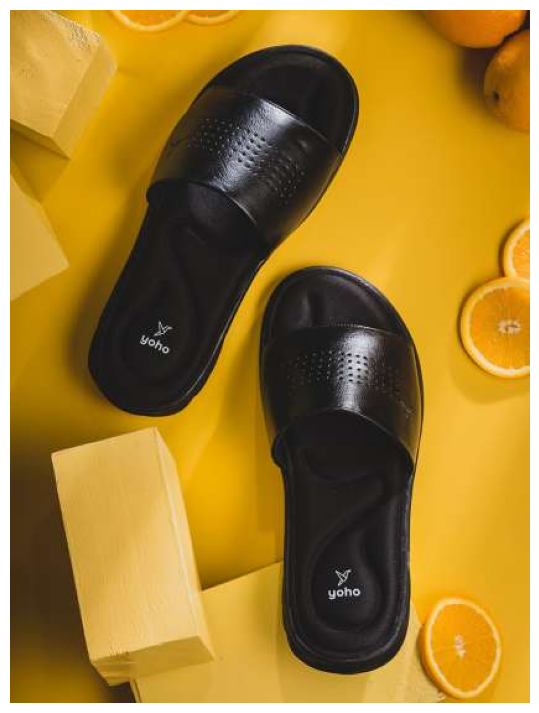

Shop Now @  https://www.myntra.com/flip-flops/yoho/yoho-men-perforated-adjustable-strap-sliders/24287360/buy


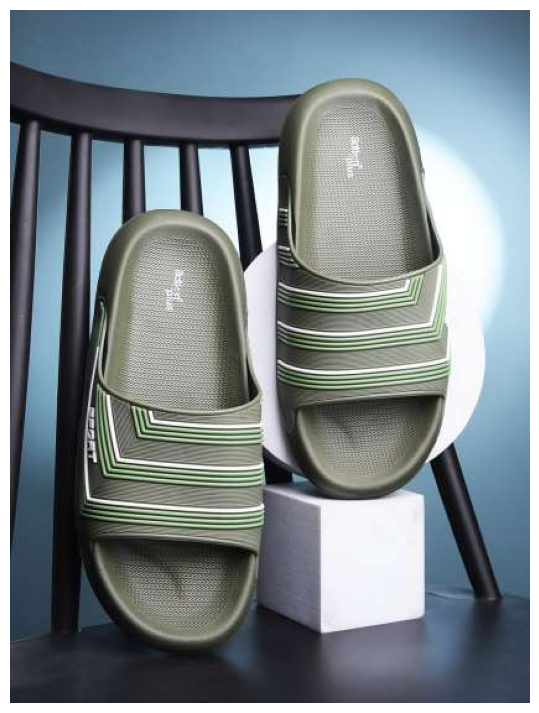

Shop Now @  https://www.myntra.com/flip-flops/action/action-men-striped-sliders/29018880/buy


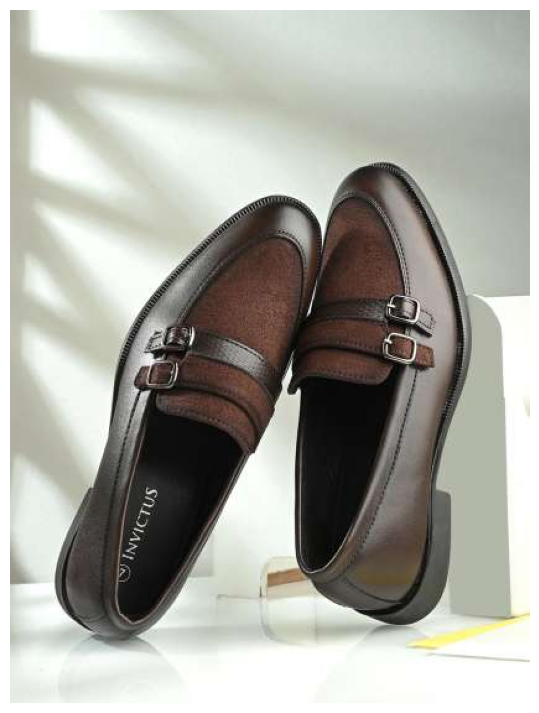

Shop Now @  https://www.myntra.com/formal-shoes/invictus/invictus-men-formal-loafers/29936738/buy


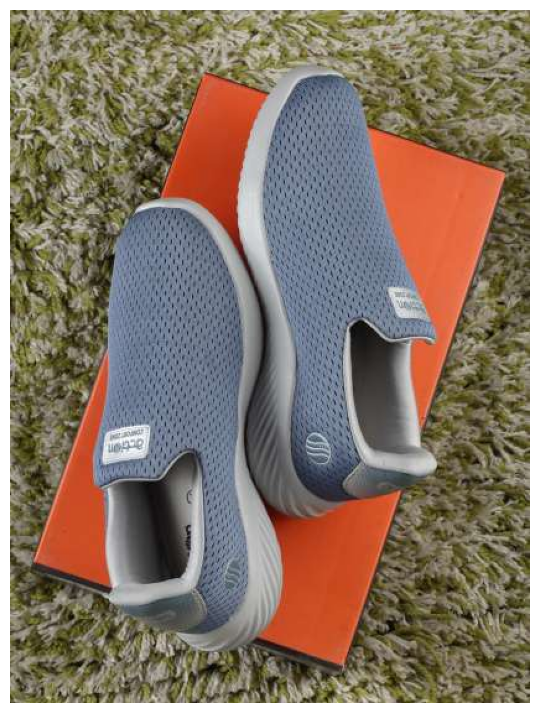

Shop Now @  https://www.myntra.com/sports-shoes/action/action-men-lightweight-running--shoes/25113190/buy


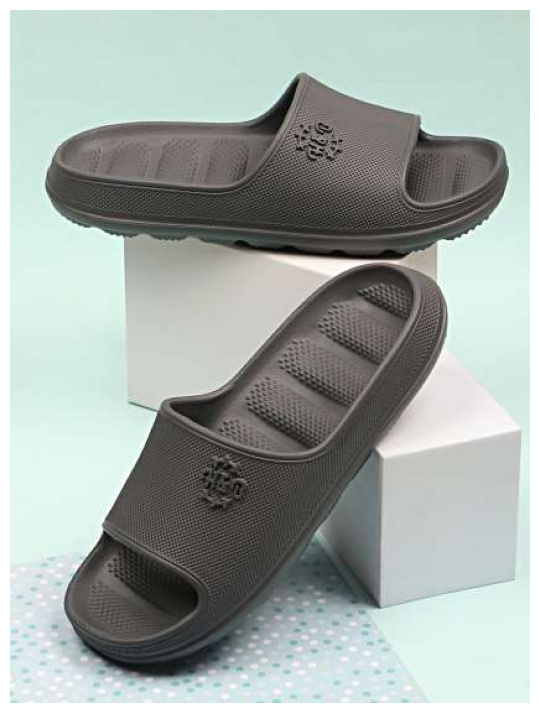

Shop Now @  https://www.myntra.com/flip-flops/neoz/neoz-men-rubber-slider-flip-flops/22243646/buy


In [85]:
tqdm.pandas()

# Randomly select an embedding as the query
query_embedding = mens_footwear.iloc[random.randint(0, mens_footwear.shape[0])].embedding

# Calculate distances between the query embedding and other embeddings
mens_footwear['distance'] = mens_footwear['embedding'].progress_apply(
    lambda x: np.linalg.norm(np.asarray(eval(x), dtype=np.float32) - np.asarray(eval(query_embedding), dtype=np.float32))
)

# Sort by distance
mens_footwear = mens_footwear.sort_values(by='distance').reset_index(drop=True)

# Display the query image
plt.figure(figsize=(16,9))

# Download and display the image from the URL
response = requests.get(mens_footwear.iloc[0].image_url)
image = Image.open(BytesIO(response.content))
plt.imshow(image)
plt.title("Query Image")
plt.axis("off")
plt.show()

print(254 * "=")
print(254 * "=")

# Display the top 10 similar images
for i, row in mens_footwear.iloc[1:11].iterrows():
    plt.figure(figsize=(16,9))
    
    # Download and display the image from the URL
    response = requests.get(row["image_url"])
    image = Image.open(BytesIO(response.content))
    plt.imshow(image)
    plt.axis("off")
    plt.show()
    
    print("Shop Now @ ", row["product_url"])
    print(254 * "=")


In [86]:
mens_eyewear = pd.read_csv("./downloaded_scrapped_data_embeddings/mens_eyewear_embeddings.csv")

  0%|          | 0/709 [00:00<?, ?it/s]

100%|██████████| 709/709 [00:01<00:00, 469.24it/s]


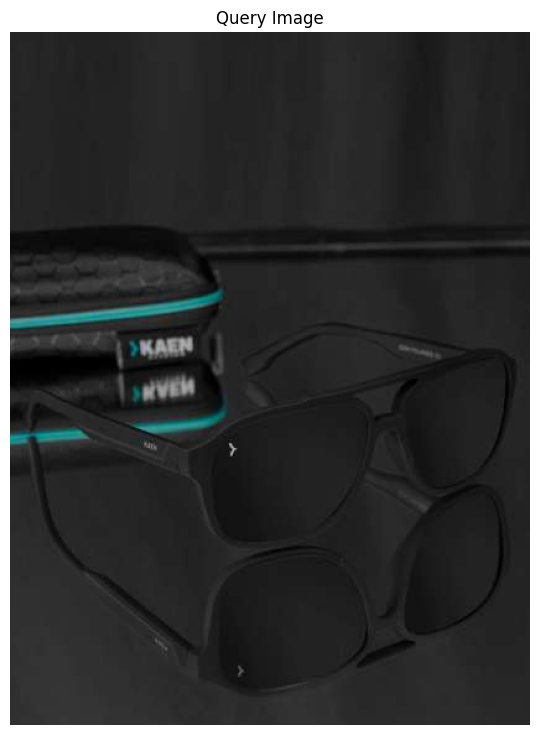

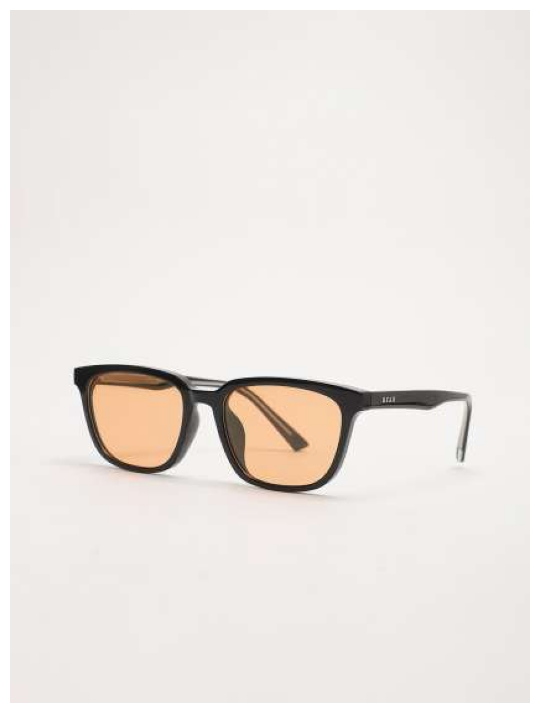

Shop Now @  https://www.myntra.com/sunglasses/the+bear+house/the-bear-house-men-rectangle-sunglasses-bsg-skiene-bk/27832572/buy


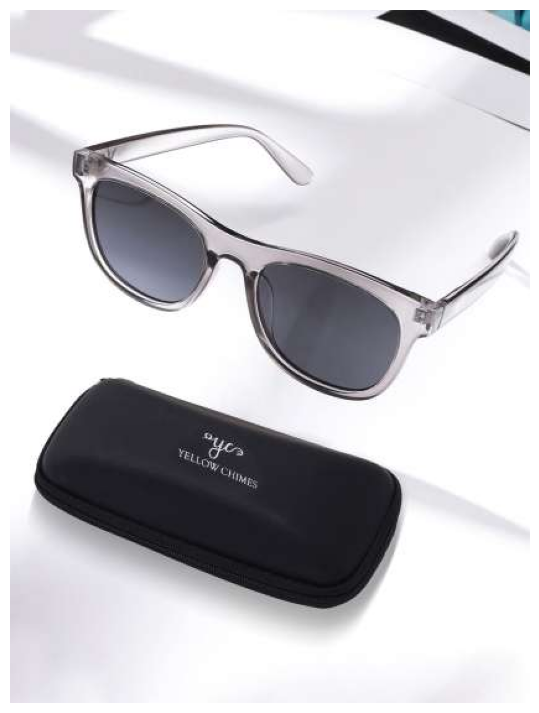

Shop Now @  https://www.myntra.com/sunglasses/yellow+chimes/yellow-chimes-round-sunglasses-with-polarised-and-uv-protected-lens-ycfjsg-005sngls-gr/23917064/buy


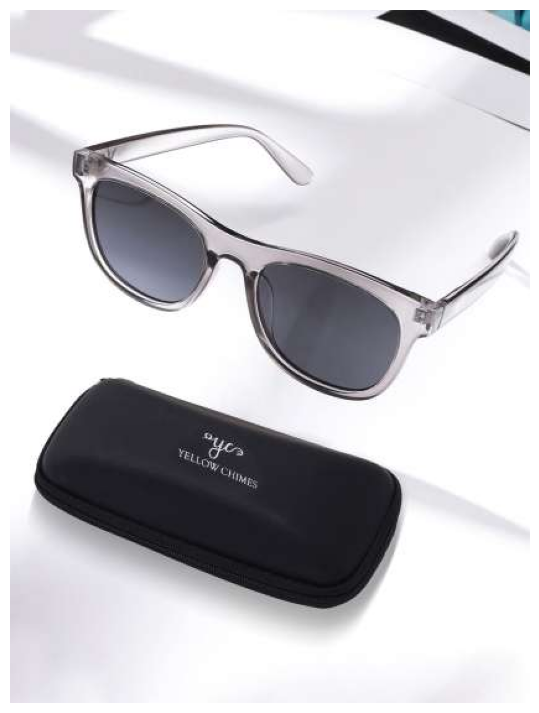

Shop Now @  https://www.myntra.com/sunglasses/yellow+chimes/yellow-chimes-round-sunglasses-with-polarised-and-uv-protected-lens-ycfjsg-005sngls-gr/23917064/buy


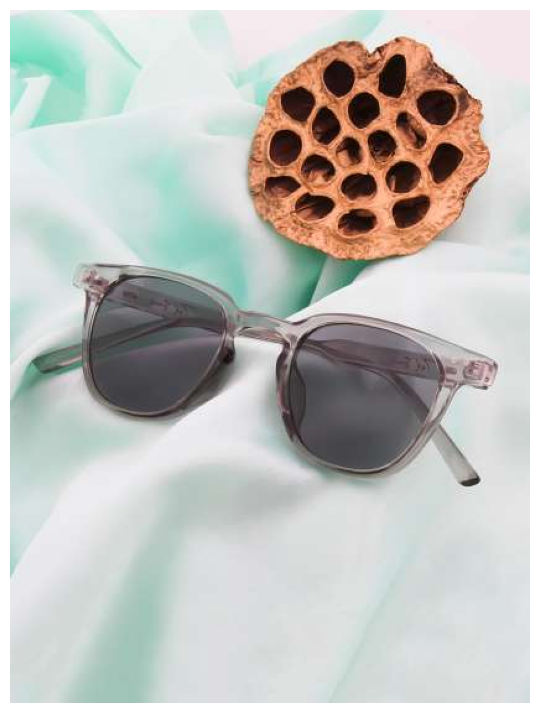

Shop Now @  https://www.myntra.com/sunglasses/ted+smith/ted-smith-unisex-grey-lens--gunmetal-wayfarer-sunglasses--uv-protected-lens-ts-opalc6/20538804/buy


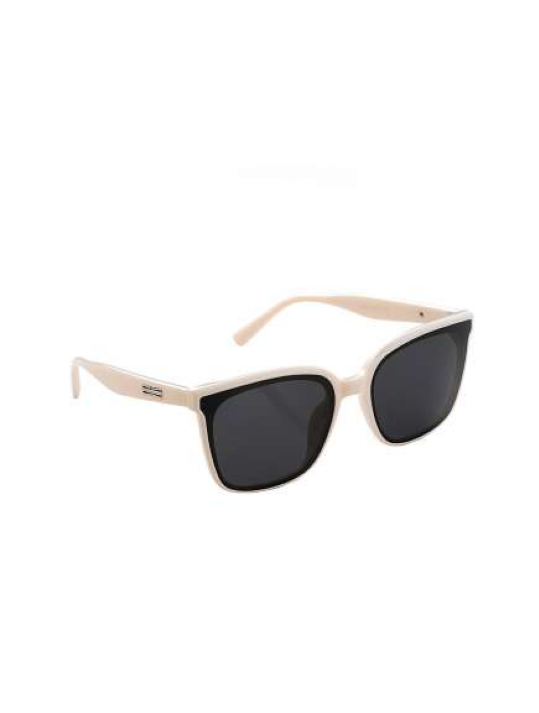

Shop Now @  https://www.myntra.com/sunglasses/hashtag+eyewear/hashtag-eyewear-unisex-wayfarer-sunglasses-with-uv-protected-lens/28546260/buy


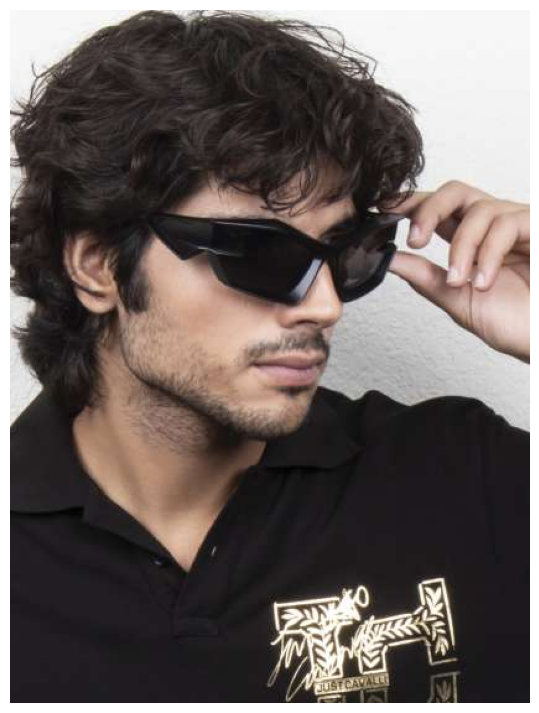

Shop Now @  https://www.myntra.com/sunglasses/ted+smith/ted-smith-sports-lens-with-uv-protected-sunglasses/23610954/buy


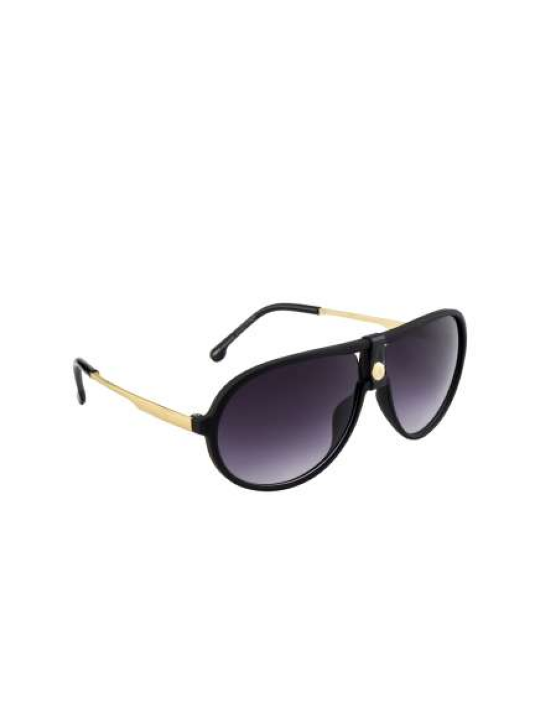

Shop Now @  https://www.myntra.com/sunglasses/mast+%26+harbour/mast--harbour-full-rim-aviator-sunglasses-with-uv-protected-lens-mh-m25120/22462890/buy


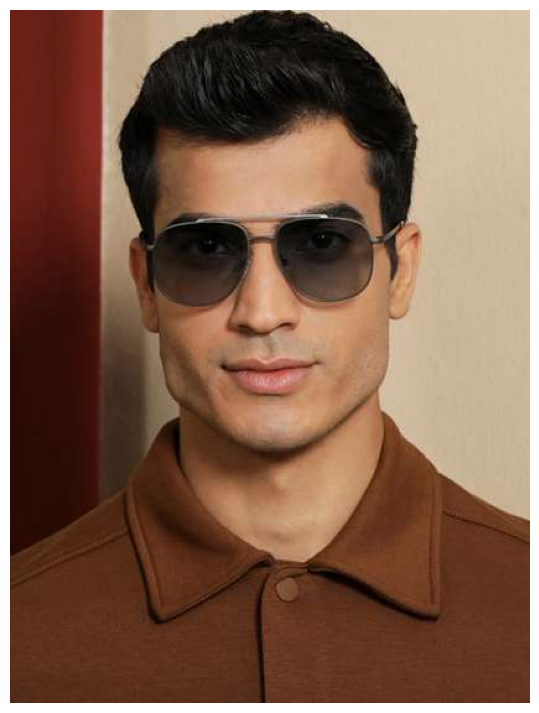

Shop Now @  https://www.myntra.com/sunglasses/vincent+chase/vincent-chase-lens--square-sunglasses-with-polarised-and-uv-protected-lens-137070/22460248/buy


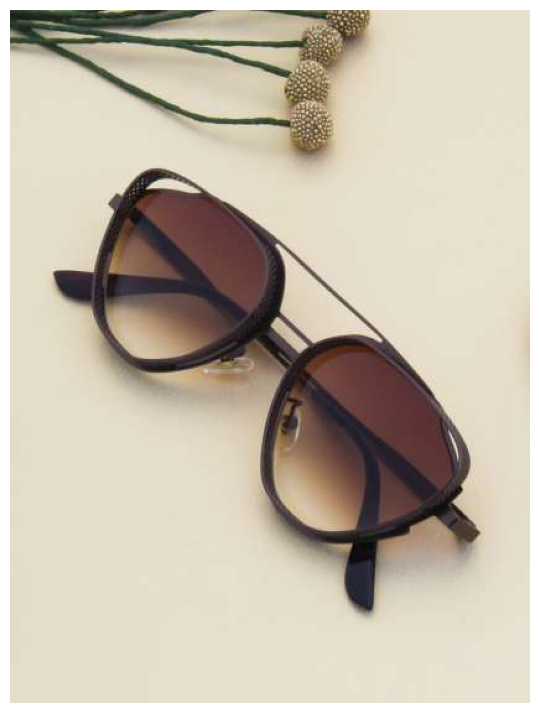

Shop Now @  https://www.myntra.com/sunglasses/ted+smith/ted-smith-unisex-brown-lens--brown-aviator-uv-protected-lens-sunglasses/17855500/buy


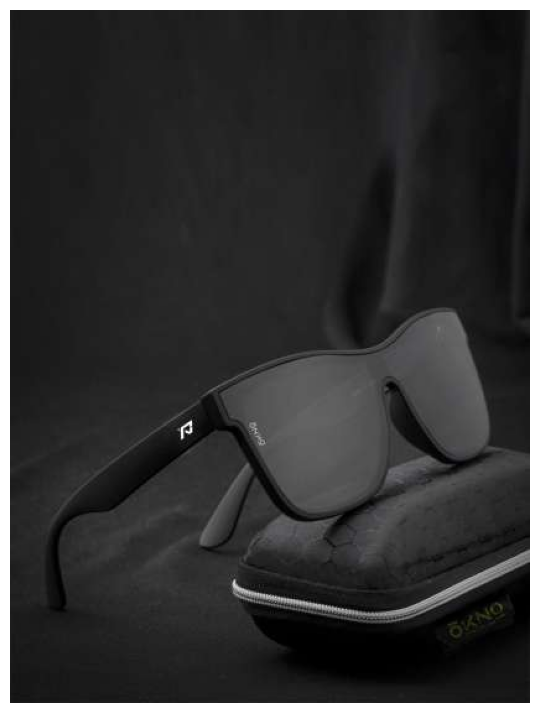

Shop Now @  https://www.myntra.com/sunglasses/okno/okno-unisex-sports-sunglasses-with-polarised-lens-okcrv2sc1el1122/24695802/buy


In [87]:
tqdm.pandas()

# Randomly select an embedding as the query
query_embedding = mens_eyewear.iloc[random.randint(0, mens_eyewear.shape[0])].embedding

# Calculate distances between the query embedding and other embeddings
mens_eyewear['distance'] = mens_eyewear['embedding'].progress_apply(
    lambda x: np.linalg.norm(np.asarray(eval(x), dtype=np.float32) - np.asarray(eval(query_embedding), dtype=np.float32))
)

# Sort by distance
mens_eyewear = mens_eyewear.sort_values(by='distance').reset_index(drop=True)

# Display the query image
plt.figure(figsize=(16,9))

# Download and display the image from the URL
response = requests.get(mens_eyewear.iloc[0].image_url)
image = Image.open(BytesIO(response.content))
plt.imshow(image)
plt.title("Query Image")
plt.axis("off")
plt.show()

print(254 * "=")
print(254 * "=")

# Display the top 10 similar images
for i, row in mens_eyewear.iloc[1:11].iterrows():
    plt.figure(figsize=(16,9))
    
    # Download and display the image from the URL
    response = requests.get(row["image_url"])
    image = Image.open(BytesIO(response.content))
    plt.imshow(image)
    plt.axis("off")
    plt.show()
    
    print("Shop Now @ ", row["product_url"])
    print(254 * "=")


In [88]:
handbags = pd.read_csv("./downloaded_scrapped_data_embeddings/handbags_embeddings.csv")

100%|██████████| 706/706 [00:01<00:00, 484.67it/s]


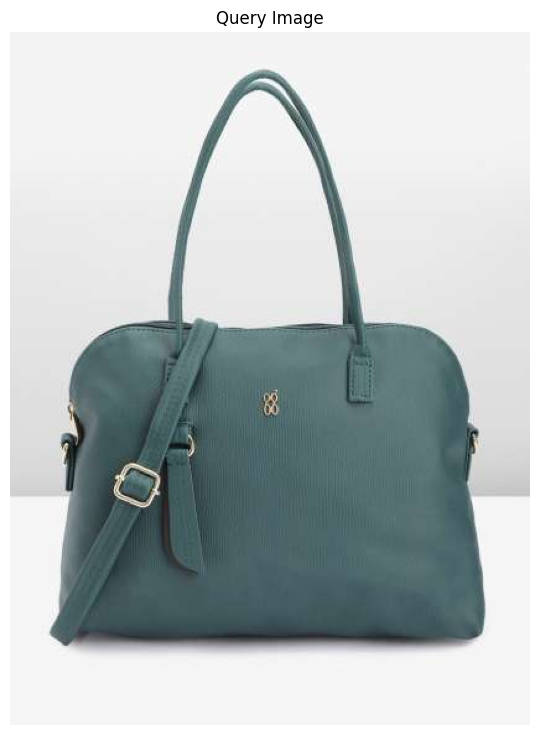

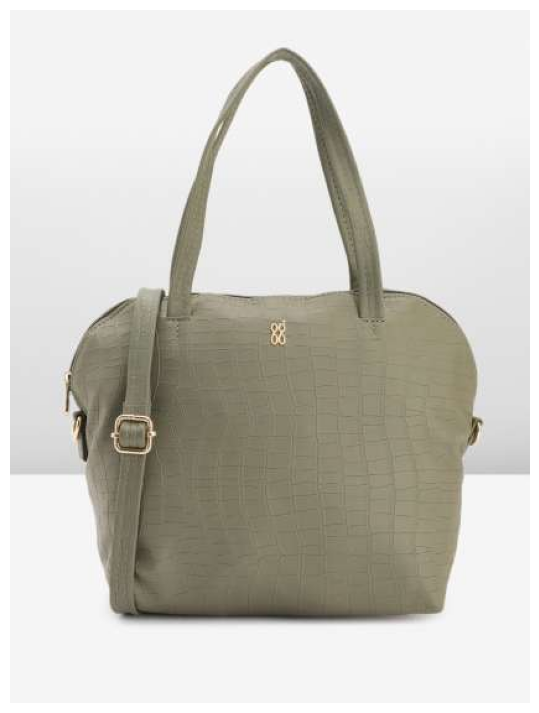

Shop Now @  https://www.myntra.com/handbags/baggit/baggit-animal-textured-structured-handheld-bag/22237334/buy


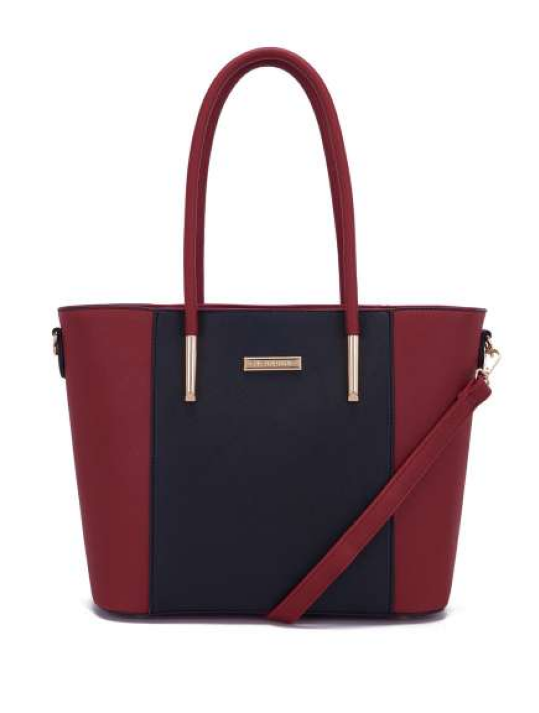

Shop Now @  https://www.myntra.com/handbags/giordano/giordano-colourblocked-structured-shoulder-bag/26823622/buy


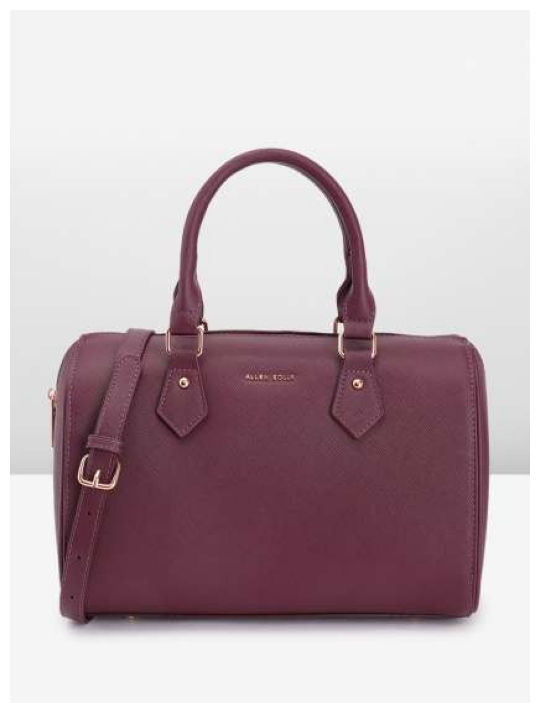

Shop Now @  https://www.myntra.com/handbags/allen+solly/allen-solly-handheld-bag/29441026/buy


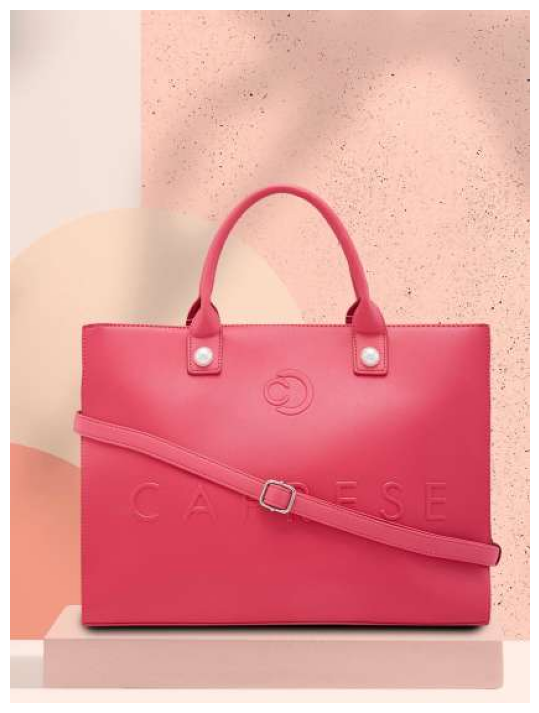

Shop Now @  https://www.myntra.com/handbags/caprese/caprese-the-kiara-collection-cloud-tote-large-handbag/29485566/buy


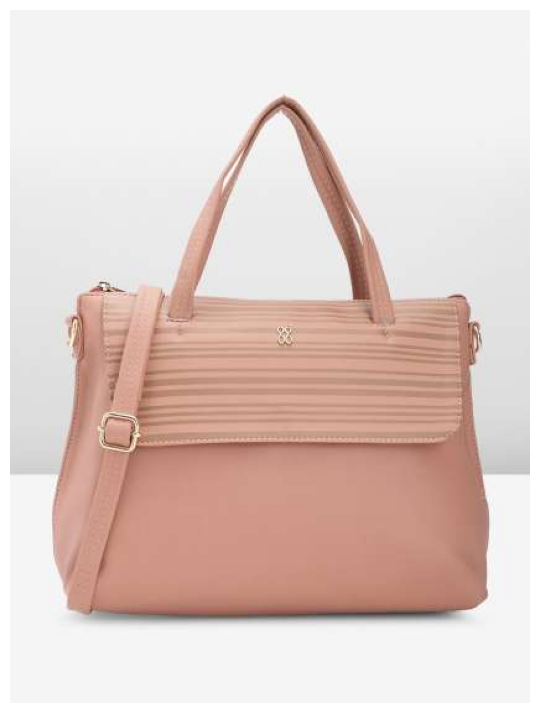

Shop Now @  https://www.myntra.com/handbags/baggit/baggit-women-striped-handheld-bag/23739110/buy


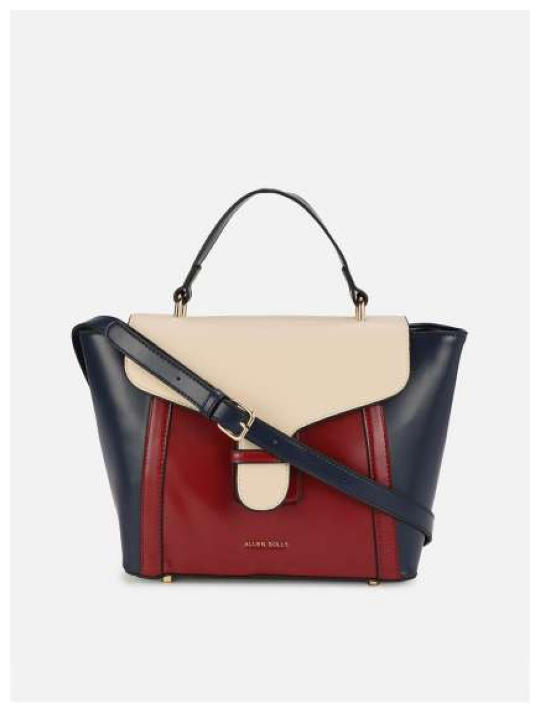

Shop Now @  https://www.myntra.com/handbags/allen+solly/allen-solly-navy-blue--maroon-colourblocked-pu-structured-satchel/19088904/buy


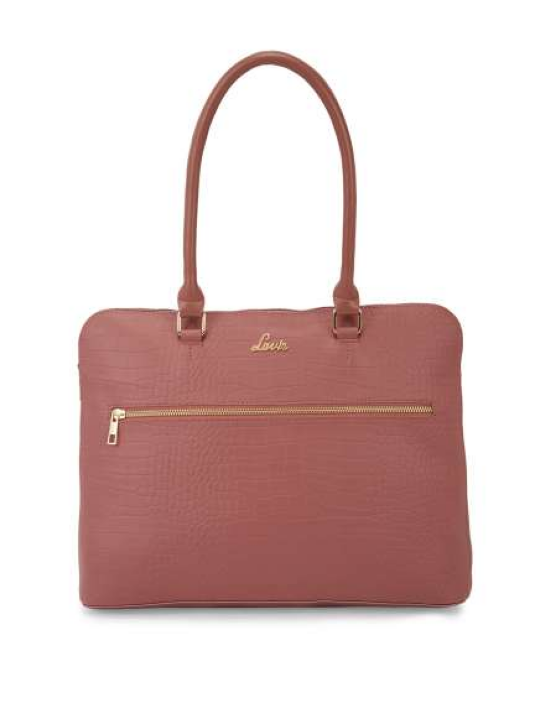

Shop Now @  https://www.myntra.com/handbags/lavie/lavie-crocodile-textured-structured-shoulder-bag/24241942/buy


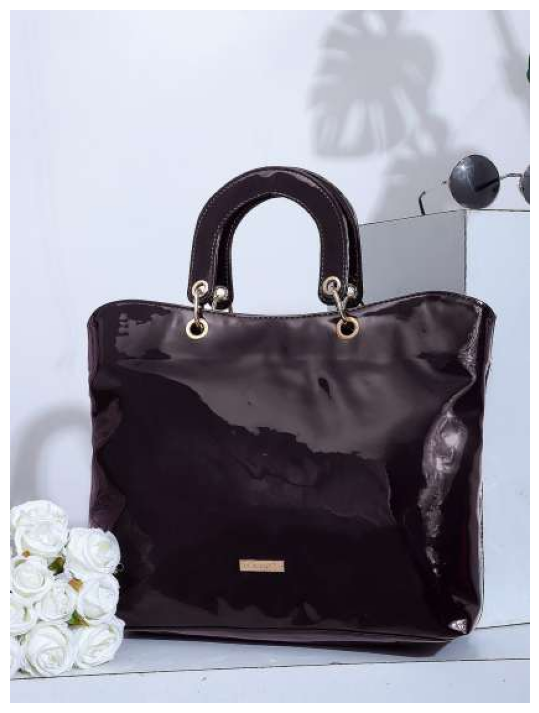

Shop Now @  https://www.myntra.com/handbags/osaiz/osaiz-shopper-handheld-bag/24551094/buy


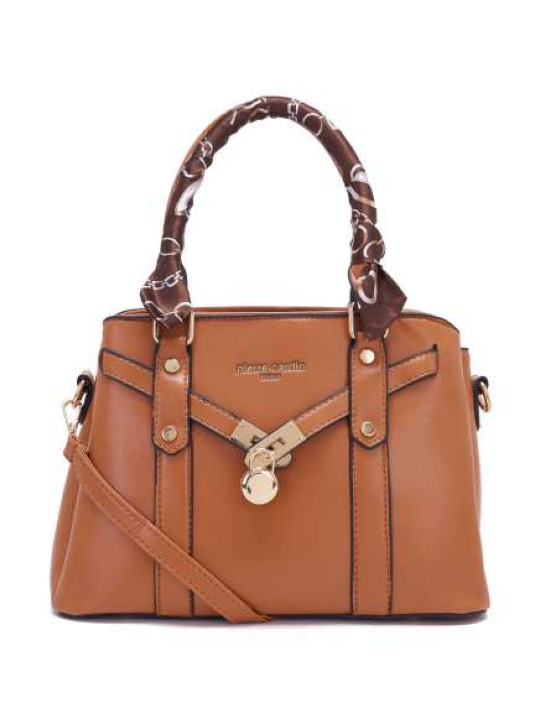

Shop Now @  https://www.myntra.com/handbags/pierre+cardin/pierre-cardin-structured-handheld-bag/26781310/buy


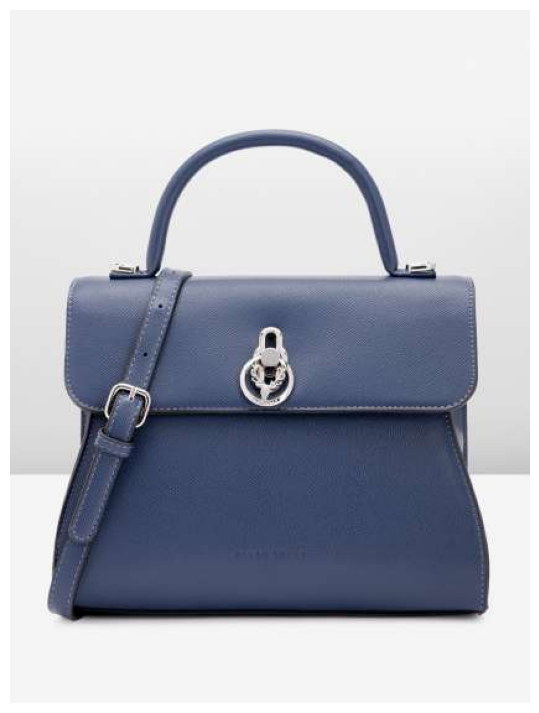

Shop Now @  https://www.myntra.com/handbags/allen+solly/allen-solly-structured-satchel/24382200/buy


In [89]:
tqdm.pandas()

# Randomly select an embedding as the query
query_embedding = handbags.iloc[random.randint(0, handbags.shape[0])].embedding

# Calculate distances between the query embedding and other embeddings
handbags['distance'] = handbags['embedding'].progress_apply(
    lambda x: np.linalg.norm(np.asarray(eval(x), dtype=np.float32) - np.asarray(eval(query_embedding), dtype=np.float32))
)

# Sort by distance
handbags = handbags.sort_values(by='distance').reset_index(drop=True)

# Display the query image
plt.figure(figsize=(16,9))

# Download and display the image from the URL
response = requests.get(handbags.iloc[0].image_url)
image = Image.open(BytesIO(response.content))
plt.imshow(image)
plt.title("Query Image")
plt.axis("off")
plt.show()

print(254 * "=")
print(254 * "=")

# Display the top 10 similar images
for i, row in handbags.iloc[1:11].iterrows():
    plt.figure(figsize=(16,9))
    
    # Download and display the image from the URL
    response = requests.get(row["image_url"])
    image = Image.open(BytesIO(response.content))
    plt.imshow(image)
    plt.axis("off")
    plt.show()
    
    print("Shop Now @ ", row["product_url"])
    print(254 * "=")
